## **1. Installation**

Update to Tensorflow 2.5

In [ ]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Update CUDA for TF 2.5
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64/libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb
!dpkg -i libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb
# Check if package has been installed
!ls -l /usr/lib/x86_64-linux-gnu/libcudnn.so.*
# Upgrade Tensorflow
!pip install --upgrade tensorflow==2.5.0

--2022-12-27 13:45:38--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64/libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb
Resolving developer.download.nvidia.com (developer.download.nvidia.com)... 152.195.19.142
Connecting to developer.download.nvidia.com (developer.download.nvidia.com)|152.195.19.142|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 430460776 (411M) [application/x-deb]
Saving to: ‘libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb’

libcudnn8_8.1.0.77- 100%[===================>] 410.52M   238MB/s    in 1.7s    

2022-12-27 13:45:40 (238 MB/s) - ‘libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb’ saved [430460776/430460776]

dpkg: warning: downgrading libcudnn8 from 8.1.1.33-1+cuda11.2 to 8.1.0.77-1+cuda11.2
(Reading database ... 124016 files and directories currently installed.)
Preparing to unpack libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb ...
Unpacking libcudnn8 (8.1.0.77-1+cuda11.2) over (8.1.1.33-1+cuda11.2) ...
Setting up libcudnn8 (8.1.0.77-1+c

In [ ]:
%cd /content/drive/MyDrive/DATA/Model
!wget https://pysource.com/extra_files/maskrcnn_colab_demo_commit_17.zip
!unzip maskrcnn_colab_demo_commit_17.zip

/content/drive/MyDrive/DATA/Model
--2022-12-27 13:47:44--  https://pysource.com/extra_files/maskrcnn_colab_demo_commit_17.zip
Resolving pysource.com (pysource.com)... 172.67.180.33, 104.21.67.193, 2606:4700:3031::6815:43c1, ...
Connecting to pysource.com (pysource.com)|172.67.180.33|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 59340 (58K) [application/zip]
Saving to: ‘maskrcnn_colab_demo_commit_17.zip.2’

maskrcnn_colab_demo 100%[===================>]  57.95K  --.-KB/s    in 0.01s   

2022-12-27 13:47:44 (4.73 MB/s) - ‘maskrcnn_colab_demo_commit_17.zip.2’ saved [59340/59340]

Archive:  maskrcnn_colab_demo_commit_17.zip
replace maskrcnn_colab/mrcnn_demo/config.py? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: maskrcnn_colab/mrcnn_demo/config.py  
  inflating: maskrcnn_colab/mrcnn_demo/model.py  
  inflating: maskrcnn_colab/mrcnn_demo/m_rcnn.py  
  inflating: maskrcnn_colab/mrcnn_demo/parallel_model.py  
  inflating: maskrcnn_colab/mrcnn_demo/utils.py 

In [ ]:
%cd /content/drive/MyDrive/DATA/Model/maskrcnn_colab/mrcnn_demo/
!ls

/content/drive/MyDrive/DATA/Model/maskrcnn_colab/mrcnn_demo
config.py  m_rcnn.py	      __pycache__  visualize.py
model.py   parallel_model.py  utils.py


In [ ]:
import sys
sys.path.append("/content/drive/MyDrive/DATA/Model/maskrcnn_colab/mrcnn_demo/")
from m_rcnn import *
%matplotlib inline

VERS 0.4 - updated 04/08/2022
... done downloading pretrained model!


In [ ]:
!nvidia-smi

Tue Dec 27 09:47:37 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   56C    P0    29W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## **2. Image Dataset**

Load your annotated dataset


In [ ]:
extract_images(os.path.join("/content/", "/content/drive/MyDrive/DATA/images_val.zip"), "/content/data")

Extracted: 137 images


In [ ]:
# Extract Images
images_path = "/content/drive/MyDrive/DATA/images.zip"
annotations_path = "/content/drive/MyDrive/DATA/Bản sao của labels_thainhi.json"

extract_images(os.path.join("/content/",images_path), "/content/dataset")

Extracted: 502 images


In [ ]:
dataset_train = load_image_dataset(os.path.join("/content/", annotations_path), "/content/dataset", "train")
dataset_val = load_image_dataset(os.path.join("/content/", annotations_path), "/content/dataset", "val")
class_number = dataset_train.count_classes()
print('Train: %d' % len(dataset_train.image_ids))
print('Validation: %d' % len(dataset_val.image_ids))
print("Classes: {}".format(class_number))

Annotation json path:  /content/drive/MyDrive/DATA/Bản sao của labels_thainhi.json
Annotation json path:  /content/drive/MyDrive/DATA/Bản sao của labels_thainhi.json
Train: 444
Validation: 55
Classes: 1


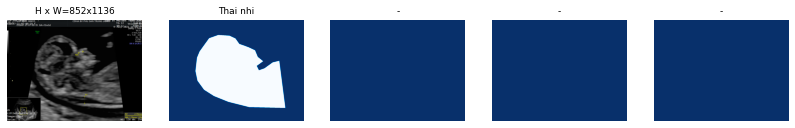

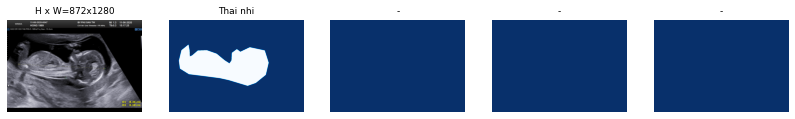

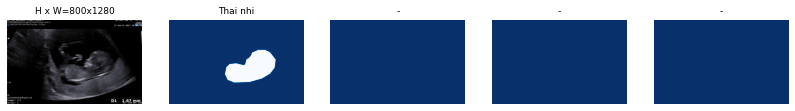

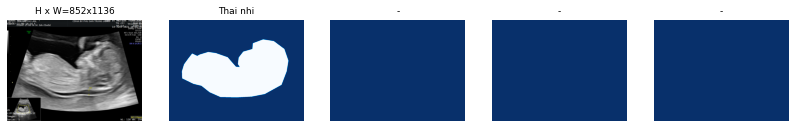

In [ ]:
# Load image samples
display_image_samples(dataset_train)

##**3. Training**

Train Mask RCNN on your custom Dataset.

In [ ]:
# Load Configuration
config = CustomConfig(class_number)
# config.display()
model = load_training_model(config)

Instructions for updating:
The `validate_indices` argument has no effect. Indices are always validated on CPU and never validated on GPU.


/content/drive/MyDrive/DATA/Model/maskrcnn_colab/mask_rcnn_coco.h5


In [ ]:
# Start Training
# This operation might take a long time.
train_head(model, dataset_train, dataset_val, config)


Starting at epoch 0. LR=0.001

Checkpoint Path: /content/drive/MyDrive/DATA/Model/maskrcnn_colab/logs/object20221227T1350/mask_rcnn_object_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
rpn_model              (Functional)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_bbox_fc          (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask_bn4         (TimeDistrib

##**3.2 Training 2:**

In [ ]:
def load_continue_training_model(config):
    model = modellib.MaskRCNN(mode="training", config=config,
                              model_dir=MODEL_DIR)

    # Which weights to start with?
    init_with = "last"  # imagenet, coco, or last

    if init_with == "imagenet":
        model.load_weights(model.get_imagenet_weights(), by_name=True)
    elif init_with == "coco":
        # Load weights trained on MS COCO, but skip layers that
        # are different due to the different number of classes
        # See README for instructions to download the COCO weights
        print(COCO_MODEL_PATH)
        model.load_weights(COCO_MODEL_PATH, by_name=True,
                           exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",
                                    "mrcnn_bbox", "mrcnn_mask"])
    elif init_with == "last":
        # Load the last model you trained and continue training
        model.load_weights(model.find_last(), by_name=True)

    return model

In [ ]:
model_path = '/content/maskrcnn_colab/logs/object20221205T1133/mask_rcnn_object_0003.h5'
model_1, inference_config = load_inference_model(class_number, model_path)
model_1 = load_training_model(inference_config)

Instructions for updating:
Use fn_output_signature instead


Loading weights from  /content/maskrcnn_colab/logs/object20221205T1133/mask_rcnn_object_0003.h5
Re-starting from epoch 3
/content/maskrcnn_colab/mask_rcnn_coco.h5


In [ ]:
class CustomDataset_1(utils.Dataset):
    """ Generates a COCO-like dataset, i.e. an image dataset annotated in the style of the COCO dataset.
        See http://cocodataset.org/#home for more information.
    """

    def load_custom_1(self, annotation_json, images_dir, dataset_type="train"):
        """ Load the coco-like dataset from json
        Args:
            annotation_json: The path to the coco annotations json file
            images_dir: The directory holding the images referred to by the json file
        """

        # Load json from file
        print("Annotation json path: ", annotation_json)
        json_file = open(annotation_json)
        coco_json = json.load(json_file)
        json_file.close()


        # Add the class names using the base method from utils.Dataset
        source_name = "coco_like"
        for category in coco_json['categories']:
            class_id = category['id']

            class_name = category['name']
            if class_id < 1:
                print('Error: Class id for "{}" cannot be less than one. (0 is reserved for the background)'.format(
                    class_name))
                return

            self.add_class(source_name, class_id, class_name)

        # Get all annotations
        annotations = {}
        for annotation in coco_json['annotations']:
            image_id = annotation['image_id']
            if image_id not in annotations:
                annotations[image_id] = []
            annotations[image_id].append(annotation)

        # Get all images and add them to the dataset
        seen_images = {}

        # Split the dataset, if train, get 90%, else 10%
        len_images = len(coco_json['images'])
        if dataset_type == "train":
            img_range = [0, len_images]
        else:
            img_range = [0, 0]

        for i in range(img_range[0], img_range[1]):
            image = coco_json['images'][i]
            image_id = image['id']
            if image_id in seen_images:
                print("Warning: Skipping duplicate image id: {}".format(image))
            else:
                seen_images[image_id] = image
                try:
                    image_file_name = image['file_name']
                    image_width = image['width']
                    image_height = image['height']
                except KeyError as key:
                    print("Warning: Skipping image (id: {}) with missing key: {}".format(image_id, key))

                image_path = os.path.abspath(os.path.join(images_dir, image_file_name))
                image_annotations = annotations[image_id]

                # Add the image using the base method from utils.Dataset
                self.add_image(
                    source=source_name,
                    image_id=image_id,
                    path=image_path,
                    width=image_width,
                    height=image_height,
                    annotations=image_annotations
                )

    def load_mask(self, image_id):
        """ Load instance masks for the given image.
        MaskRCNN expects masks in the form of a bitmap [height, width, instances].
        Args:
            image_id: The id of the image to load masks for
        Returns:
            masks: A bool array of shape [height, width, instance count] with
                one mask per instance.
            class_ids: a 1D array of class IDs of the instance masks.
        """
        image_info = self.image_info[image_id]
        annotations = image_info['annotations']
        instance_masks = []
        class_ids = []

        for annotation in annotations:
            class_id = annotation['category_id']
            mask = Image.new('1', (image_info['width'], image_info['height']))
            mask_draw = ImageDraw.ImageDraw(mask, '1')
            for segmentation in annotation['segmentation']:
                mask_draw.polygon(segmentation, fill=1)
                bool_array = np.array(mask) > 0
                instance_masks.append(bool_array)
                class_ids.append(class_id)

        mask = np.dstack(instance_masks)
        class_ids = np.array(class_ids, dtype=np.int32)
        #print("Class_ids, ", class_ids)
        return mask, class_ids

    def count_classes_1(self):
        class_ids = set()
        for image_id in self.image_ids:
            image_info = self.image_info[image_id]
            annotations = image_info['annotations']

            for annotation in annotations:
                class_id = annotation['category_id']
                class_ids.add(class_id)

        class_number = len(class_ids)
        return class_number


In [ ]:
def load_image_dataset_custom(annotation_path, dataset_path, dataset_type):
    dataset_train = CustomDataset_1()
    dataset_train.load_custom_1(annotation_path, dataset_path, dataset_type)
    dataset_train.prepare()
    return dataset_train

In [ ]:
#Extract Images
images_path_val = "/content/drive/MyDrive/DATA/images_val.zip"
annotations_path_val = "/content/drive/MyDrive/DATA/labels_thainhi_val.json"

extract_images(os.path.join("/content/",images_path_val), "/content/dataset_valid")

Extracted: 137 images


In [ ]:
dataset_train_1 = load_image_dataset_custom(os.path.join("/content/", annotations_path_val), "/content/dataset_valid", "train")
dataset_val_1 = load_image_dataset_custom(os.path.join("/content/", annotations_path_val), "/content/dataset_valid", "val")
class_number = dataset_train_1.count_classes_1()
print('Train: %d' % len(dataset_train_1.image_ids))
print('Validation: %d' % len(dataset_val_1.image_ids))
print("Classes: {}".format(class_number))

Annotation json path:  /content/drive/MyDrive/DATA/labels_thainhi_val.json
Annotation json path:  /content/drive/MyDrive/DATA/labels_thainhi_val.json
Train: 137
Validation: 0
Classes: 1


In [ ]:
train_head(model_1, dataset_train_1, dataset_val, config)


Starting at epoch 0. LR=0.001

Checkpoint Path: /content/maskrcnn_colab/logs/object20221205T1216/mask_rcnn_object_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
rpn_model              (Functional)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_bbox_fc          (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask_bn4         (TimeDistributed)
mrcnn_mask_deconv  

##**3.3 Training 3:**

In [ ]:
model_path_2 = '/content/maskrcnn_colab/logs/object20221205T1216/mask_rcnn_object_0001.h5'
model_2, inference_config_2 = load_inference_model(class_number, model_path_2)
model_2 = load_training_model(inference_config_2)

Loading weights from  /content/maskrcnn_colab/logs/object20221205T1216/mask_rcnn_object_0001.h5
Re-starting from epoch 1
/content/maskrcnn_colab/mask_rcnn_coco.h5


In [ ]:
#Extract Images
images_path_test = "/content/drive/MyDrive/DATA/images_test.zip"
annotations_path_test = "/content/drive/MyDrive/DATA/labels_thainhi_test.json"

extract_images(os.path.join("/content/",images_path_test), "/content/dataset_test")

Extracted: 100 images


In [ ]:
dataset_train_2 = load_image_dataset_custom(os.path.join("/content/", annotations_path_test), "/content/dataset_test", "train")
dataset_val_2 = load_image_dataset_custom(os.path.join("/content/", annotations_path_test), "/content/dataset_test", "val")
class_number = dataset_train_2.count_classes_1()
print('Train: %d' % len(dataset_train_2.image_ids))
print('Validation: %d' % len(dataset_val_2.image_ids))
print("Classes: {}".format(class_number))

Annotation json path:  /content/drive/MyDrive/DATA/labels_thainhi_test.json
Annotation json path:  /content/drive/MyDrive/DATA/labels_thainhi_test.json
Train: 100
Validation: 0
Classes: 1


In [ ]:
train_head(model_2, dataset_train_2, dataset_val, config)


Starting at epoch 0. LR=0.001

Checkpoint Path: /content/maskrcnn_colab/logs/object20221205T1234/mask_rcnn_object_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
rpn_model              (Functional)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_bbox_fc          (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask_bn4         (TimeDistributed)
mrcnn_mask_deconv  

## **4. Detection (test your model on a random image)**

In [ ]:
# Load Test Model
# The latest trained model will be loaded
#test_model, inference_config = load_test_model(class_number)
model_final, inference_config = load_inference_model(class_number, model.find_last())

Instructions for updating:
Use fn_output_signature instead


Loading weights from  /content/maskrcnn_colab/logs/object20221218T1422/mask_rcnn_object_0005.h5
Re-starting from epoch 5


original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
Annotation


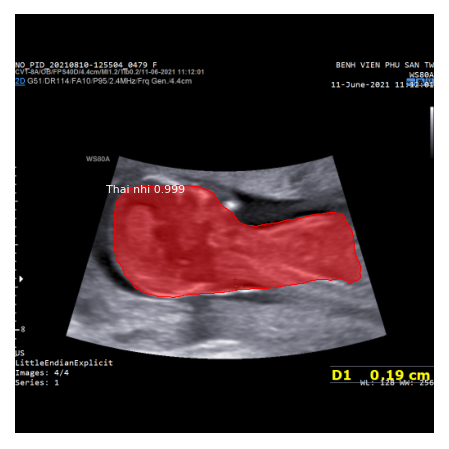

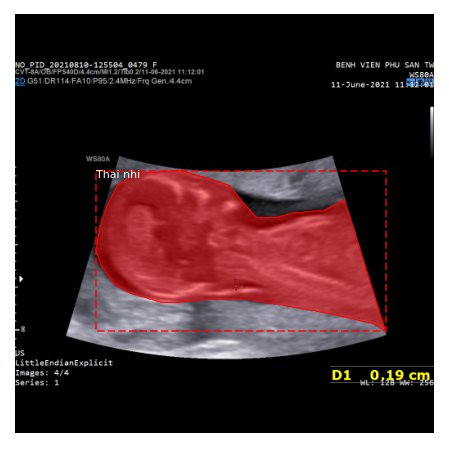

In [ ]:
test_random_image(model_final, dataset_val, inference_config)

In [ ]:
import zipfile
with zipfile.ZipFile('/content/drive/MyDrive/DATA/images_N.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/drive/MyDrive/DATA/Datasets')

In [ ]:
!pip install py7zr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 65 kB 3.8 MB/s 
     |████████████████████████████████| 139 kB 60.8 MB/s 
     |████████████████████████████████| 94 kB 3.6 MB/s 
     |████████████████████████████████| 357 kB 70.3 MB/s 
     |████████████████████████████████| 50 kB 7.5 MB/s 
     |████████████████████████████████| 378 kB 59.5 MB/s 
     |████████████████████████████████| 2.3 MB 66.5 MB/s 


In [ ]:
# x MyImageData.zip.001
!7za x /content/drive/MyDrive/DATA/images_N.zip


7-Zip (a) [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.00GHz (50653),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/DATA/                                      1 file, 193545276 bytes (185 MiB)

Extracting archive: /content/drive/MyDrive/DATA/images_N.zip
--
Path = /content/drive/MyDrive/DATA/images_N.zip
Type = zip
Physical Size = 193545276

  0%     19% 72 - images/84c34379-MAY2_0002_2.png                                          41% 170 - images/41f7f821-MAY2_0001_62.png                                            59% 247 - images/9b9acfaf-MAY2_0001_68.png

In [ ]:
import glob
list_path_file = list(glob.glob("/content/drive/MyDrive/DATA/Datasets/images/*"))
list_path_file[:20]

['/content/drive/MyDrive/DATA/Datasets/images/1592579f-P111_0004_8.png',
 '/content/drive/MyDrive/DATA/Datasets/images/84ed3b7d-P111_0001_36.png',
 '/content/drive/MyDrive/DATA/Datasets/images/9870dfdc-MAY2_0004.png',
 '/content/drive/MyDrive/DATA/Datasets/images/54c04308-P111_0005_1.png',
 '/content/drive/MyDrive/DATA/Datasets/images/0395c4a3-MAY_2_0001_26.png',
 '/content/drive/MyDrive/DATA/Datasets/images/efb61049-MAY2_0001_16.png',
 '/content/drive/MyDrive/DATA/Datasets/images/95f0992c-MAY_2_0002_14.png',
 '/content/drive/MyDrive/DATA/Datasets/images/beb221c2-P111_0006_6.png',
 '/content/drive/MyDrive/DATA/Datasets/images/5956b5ad-MAY2_0002_23.png',
 '/content/drive/MyDrive/DATA/Datasets/images/b21de7d8-P111_0002_10.png',
 '/content/drive/MyDrive/DATA/Datasets/images/2d0ff7e4-MAY2_0001_58.png',
 '/content/drive/MyDrive/DATA/Datasets/images/1cd5d3f2-P111_0003_26.png',
 '/content/drive/MyDrive/DATA/Datasets/images/b10436ad-P111_0004_1.png',
 '/content/drive/MyDrive/DATA/Datasets/imag

In [ ]:
len(list_path_file)

422

In [ ]:
def display_instances_custom(image, boxes, masks, class_ids, class_names,
                      scores=None, title="",
                      figsize=(16, 16), ax=None,
                      show_mask=True, show_bbox=True,
                      colors=None, captions=None):
    """
    boxes: [num_instance, (y1, x1, y2, x2, class_id)] in image coordinates.
    masks: [height, width, num_instances]
    class_ids: [num_instances]
    class_names: list of class names of the dataset
    scores: (optional) confidence scores for each box
    title: (optional) Figure title
    show_mask, show_bbox: To show masks and bounding boxes or not
    figsize: (optional) the size of the image
    colors: (optional) An array or colors to use with each object
    captions: (optional) A list of strings to use as captions for each object
    """
    # Number of instances
    N = boxes.shape[0]
    if not N:
        print("\n*** No instances to display * \n")
    else:
        assert boxes.shape[0] == masks.shape[-1] == class_ids.shape[0]

    # If no axis is passed, create one and automatically call show()
    auto_show = False
    if not ax:
        _, ax = plt.subplots(1, figsize=figsize)
        auto_show = True

    # Generate random colors
    colors = colors or random_colors(N, opencv=False)

    # Show area outside image boundaries.
    height, width = image.shape[:2]
    ax.set_ylim(height + 10, -10)
    ax.set_xlim(-10, width + 10)
    ax.axis('off')
    ax.set_title(title)

    masked_image = image.astype(np.uint32).copy()
    for i in range(N):
        color = colors[i]

        # Bounding box
        if not np.any(boxes[i]):
            # Skip this instance. Has no bbox. Likely lost in image cropping.
            continue
        y1, x1, y2, x2 = boxes[i]
        if show_bbox:
            p = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2,
                                alpha=0.7, linestyle="dashed",
                                edgecolor=color, facecolor='none')
            ax.add_patch(p)

        # Label
        if not captions:
            class_id = class_ids[i]
            score = scores[i] if scores is not None else None
            label = class_names[class_id]
            caption = "{} {:.3f}".format(label, score) if score else label
        else:
            caption = captions[i]
        ax.text(x1, y1 + 8, caption,
                color='w', size=11, backgroundcolor="none")

        # Mask
        mask = masks[:, :, i]
        if show_mask:
            masked_image = apply_mask(masked_image, mask, color)

        # Mask Polygon
        # Pad to ensure proper polygons for masks that touch image edges.
        padded_mask = np.zeros(
            (mask.shape[0] + 2, mask.shape[1] + 2), dtype=np.uint8)
        padded_mask[1:-1, 1:-1] = mask
        contours = find_contours(padded_mask, 0.5)
        for verts in contours:
            # Subtract the padding and flip (y, x) to (x, y)
            verts = np.fliplr(verts) - 1
            p = Polygon(verts, facecolor="none", edgecolor=color)
            ax.add_patch(p)
    ax.imshow(masked_image.astype(np.uint8))
    if auto_show:
        plt.show()
    return masked_image

In [ ]:
def random_colors(N, bright=True, opencv=True):
    """
    Generate random colors.
    To get visually distinct colors, generate them in HSV space then
    convert to RGB.
    """
    brightness = 255 if bright else 180
    if opencv is False:
        brightness = 1 if bright else 0.7
    hsv = [(i / N + 1, 1, brightness) for i in range(N + 1)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors

In [ ]:
import os
import sys
import random
import itertools
import colorsys
import cv2

import numpy as np
from skimage.measure import find_contours
import matplotlib.pyplot as plt
from matplotlib import patches,  lines
from matplotlib.patches import Polygon

In [ ]:
def apply_mask(image, mask, color, alpha=0.5):
    """Apply the given mask to the image.
    """
    for c in range(3):
        image[:, :, c] = np.where(mask == 1,
                                  image[:, :, c] *
                                  (1 - alpha) + alpha * color[c] * 255,
                                  image[:, :, c])
    return image

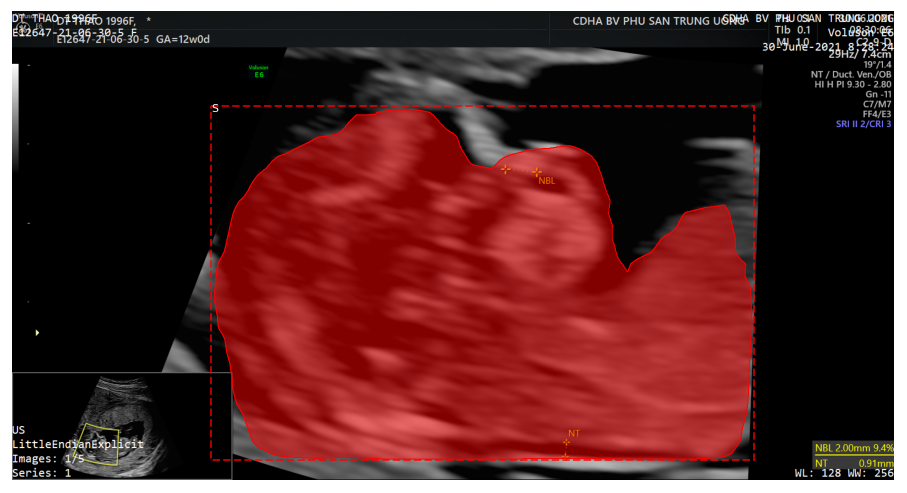

6ab7e1a6-I0000010_4.png


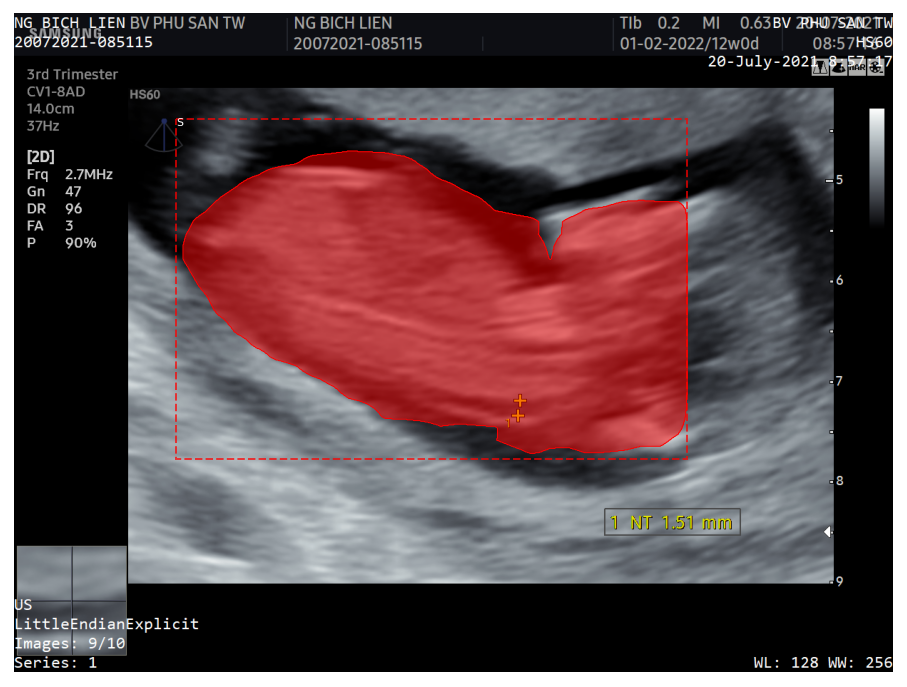

57be3dfe-I0000066.png


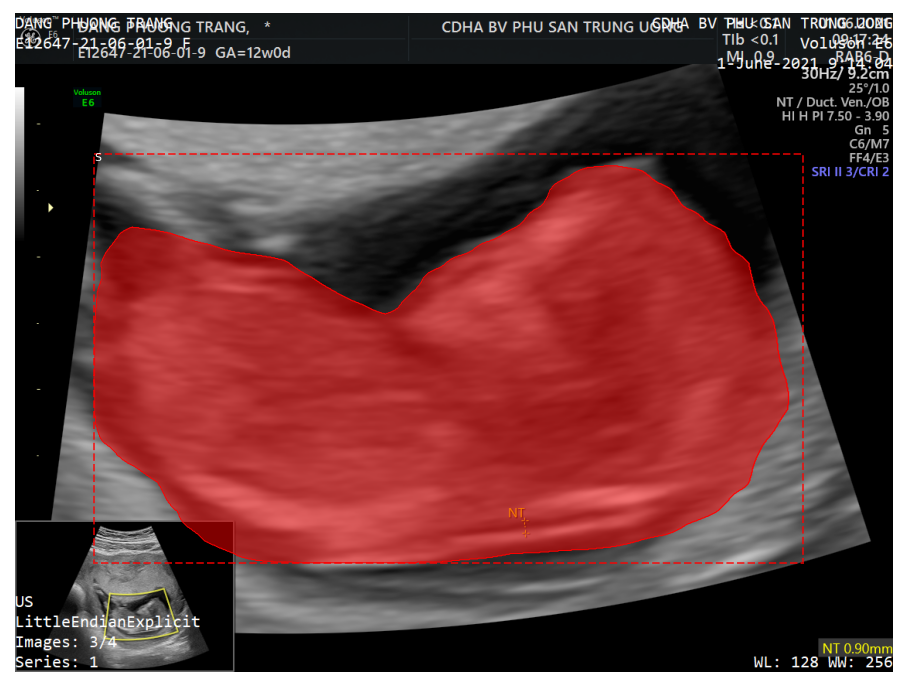

38bfc7f1-I0000030.png


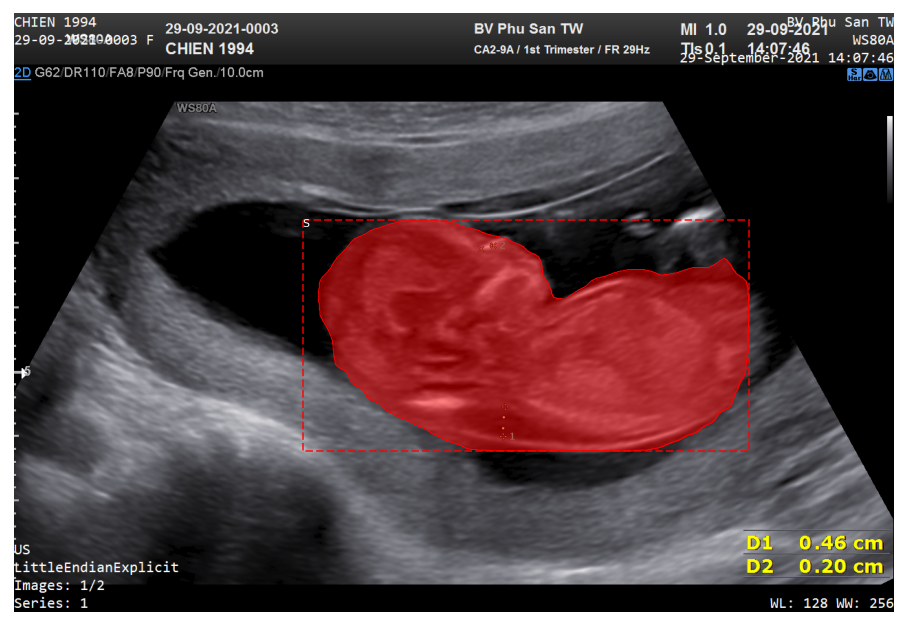

809b21f9-MAY_2_0001.png


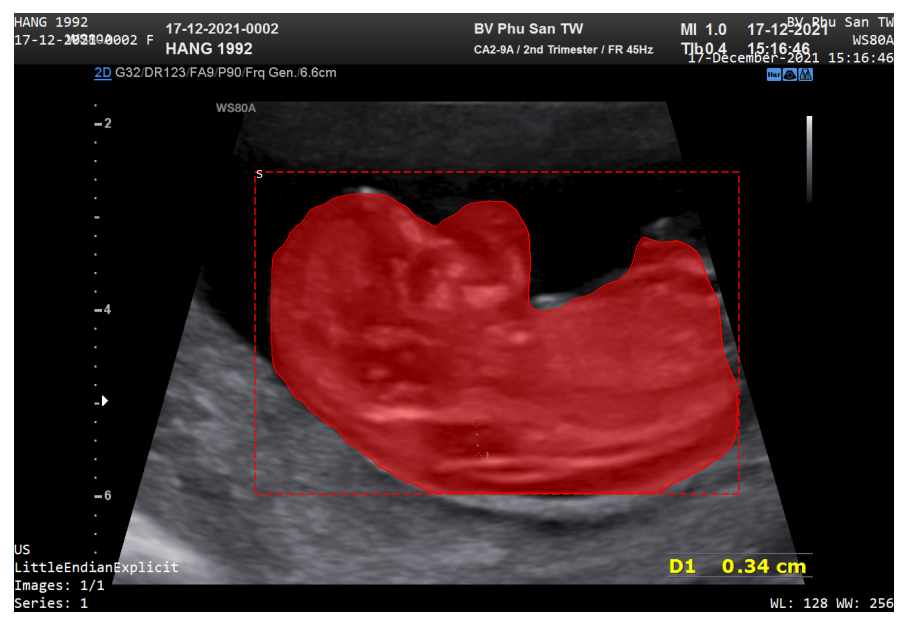

15490861-MAY_2_0001_4.png


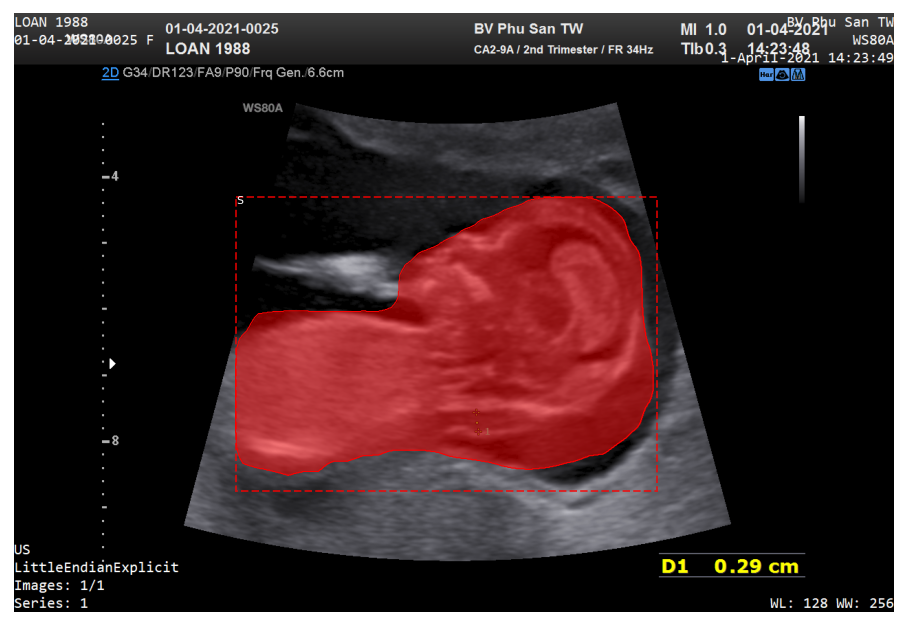

0168b9a2-MAY_2_0001_17.png


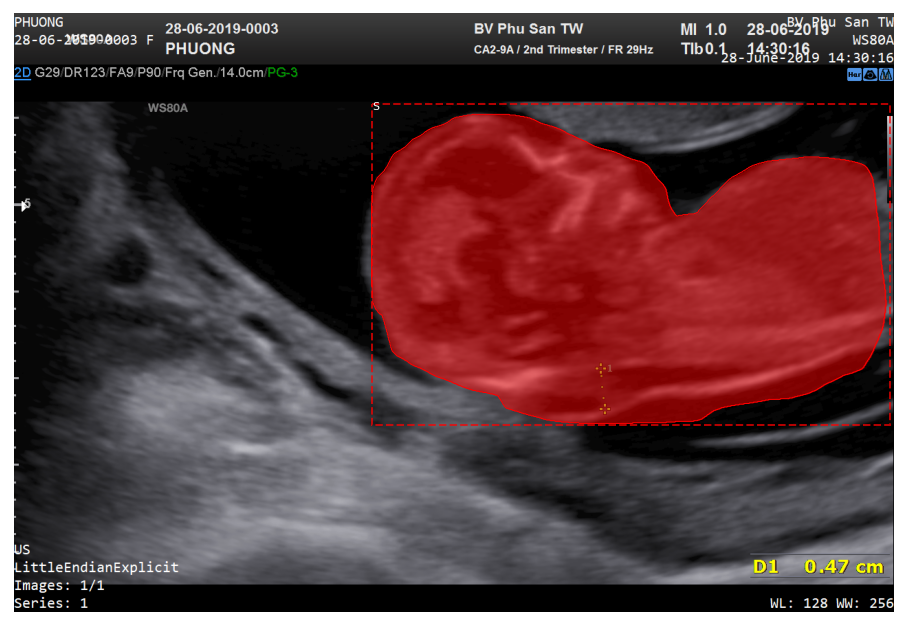

60d92a39-CLIP_0001.png


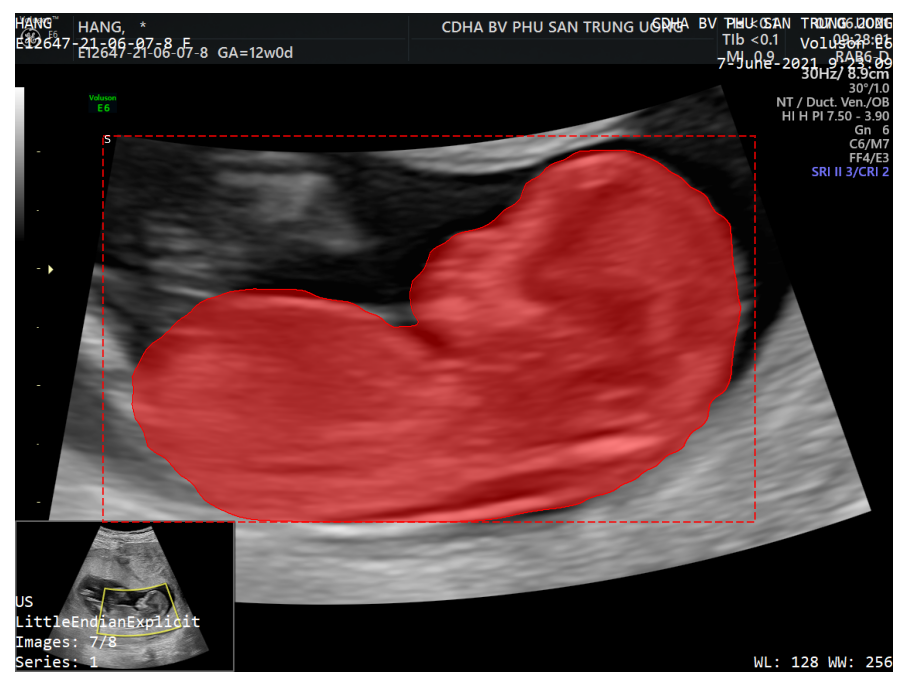

99f9c855-I0000070.png


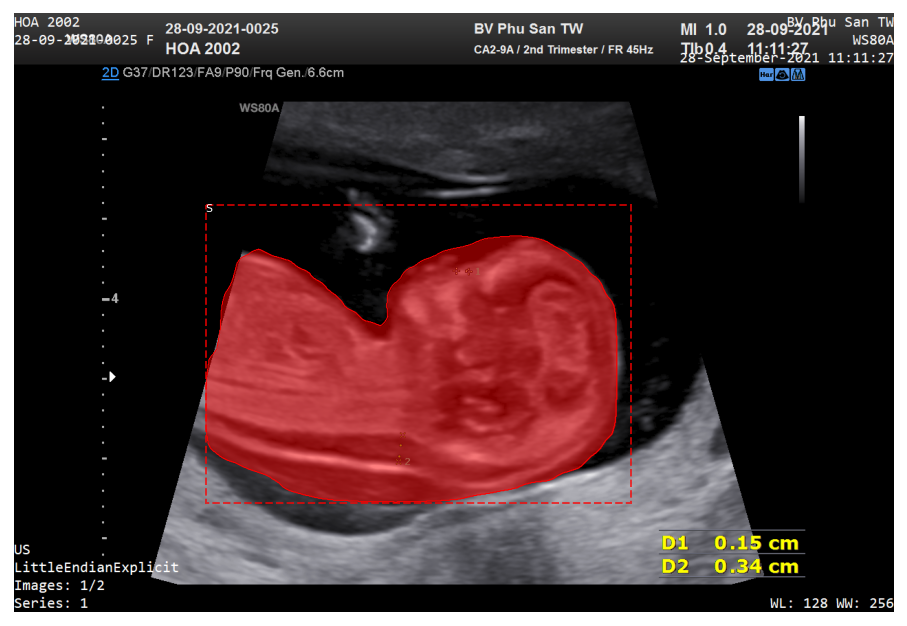

e50410c9-MAY_2_0001_8.png


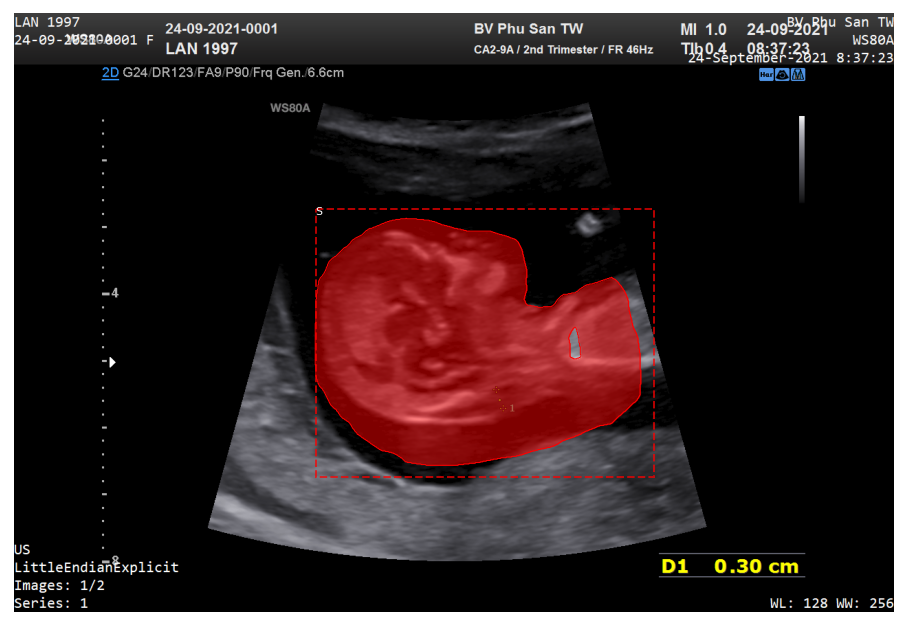

878775c4-MAY_2_0001_15.png


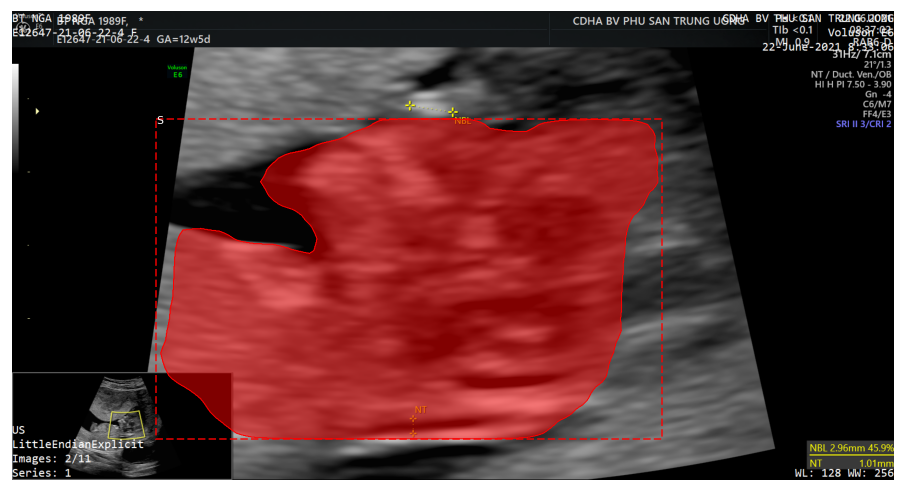

de12a62b-I0000020.png


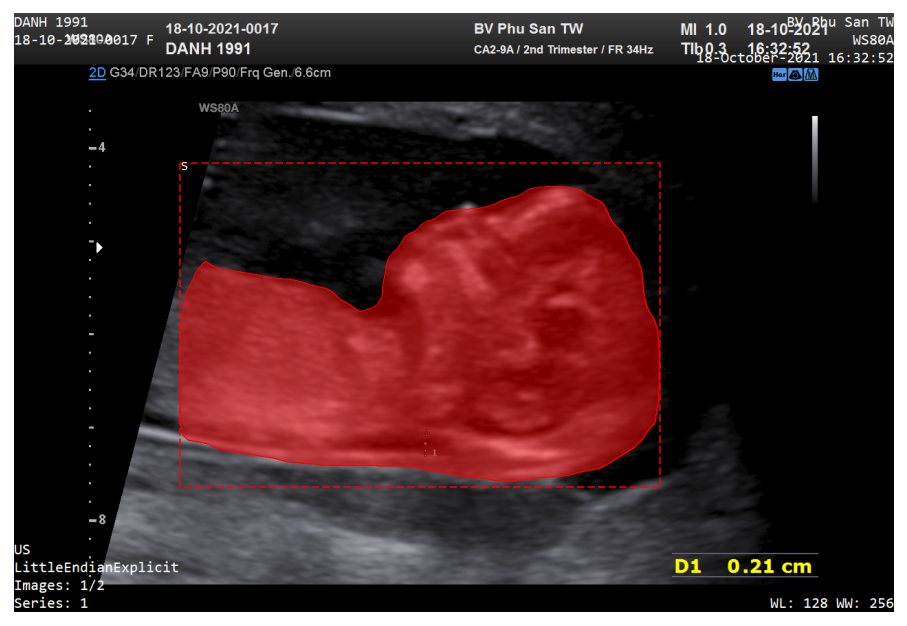

2b0dcd1b-MAY_2_0001_2.png


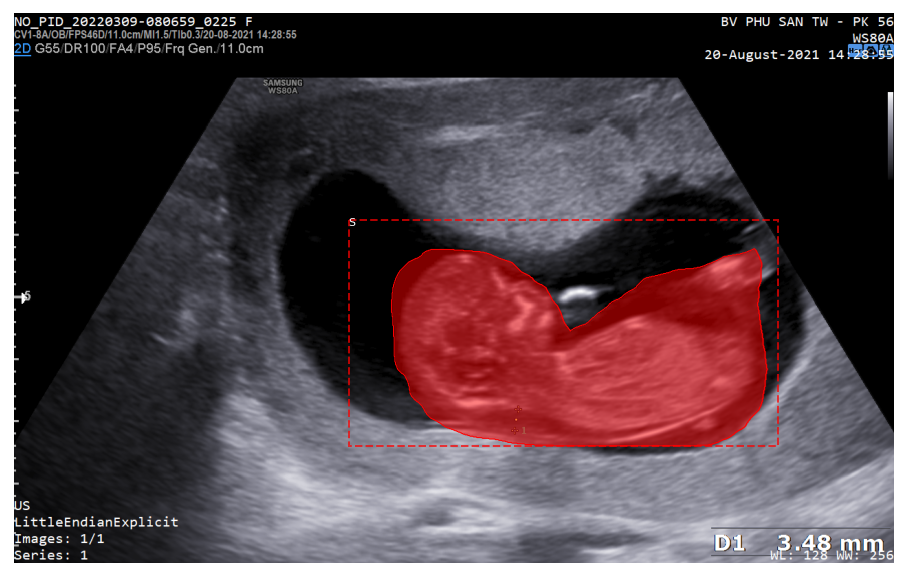

896a3742-56_1B_0001.png


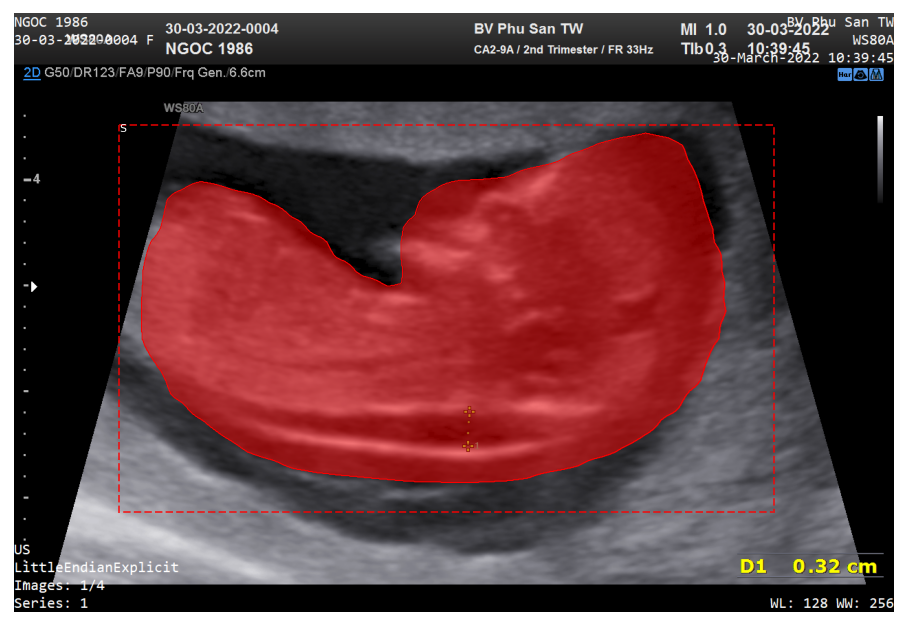

b320eb70-MAY_2_0001_18.png


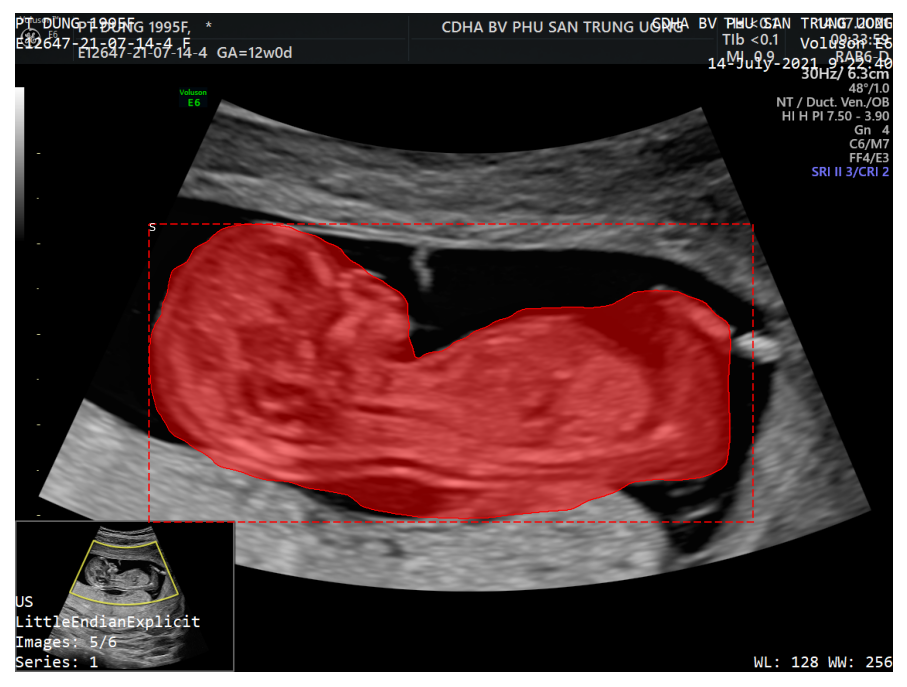

09c42062-I0000050_3.png


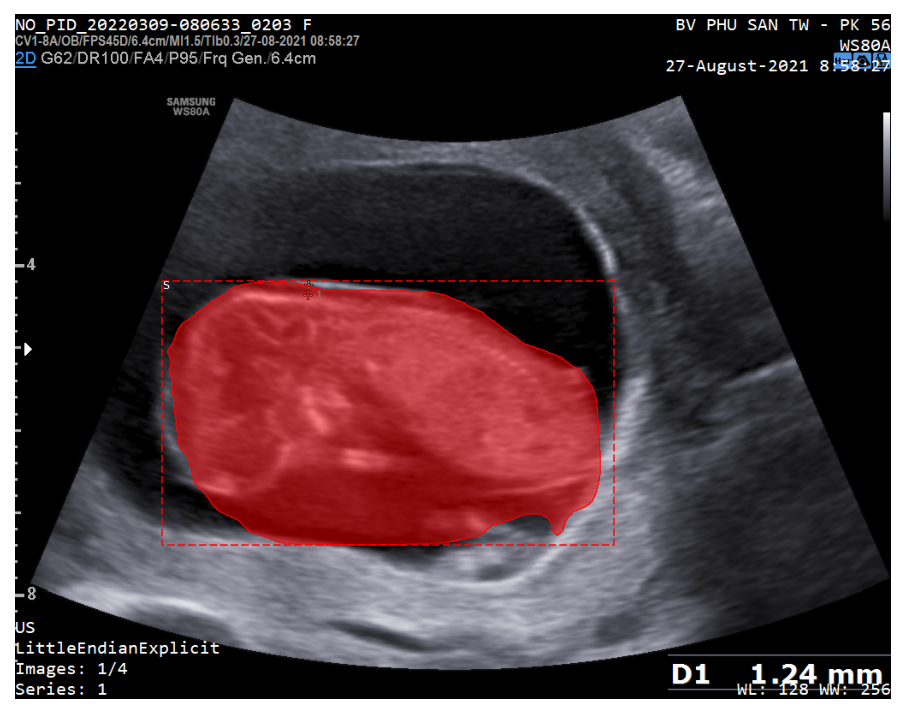

8f0da035-56_1B_0001_1.png


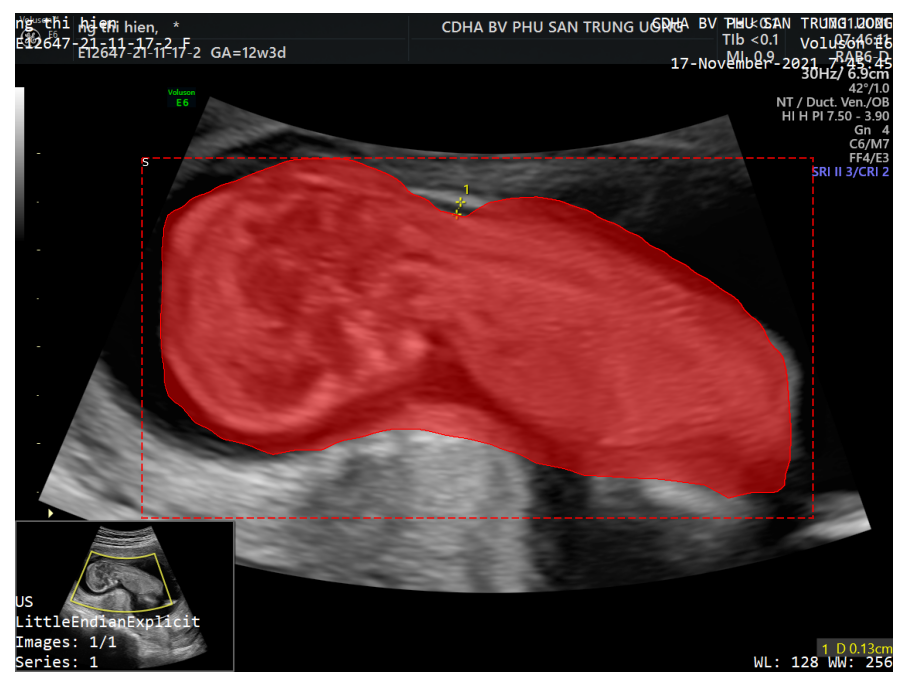

2bd1dc6c-IMG_20220329_3.png


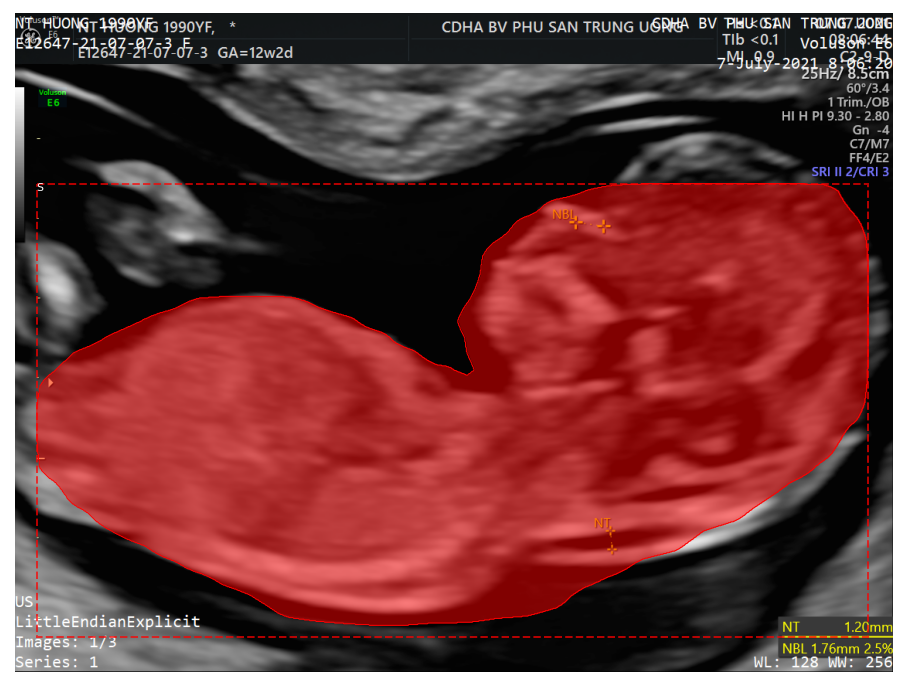

ffe81fa2-I0000010_7.png


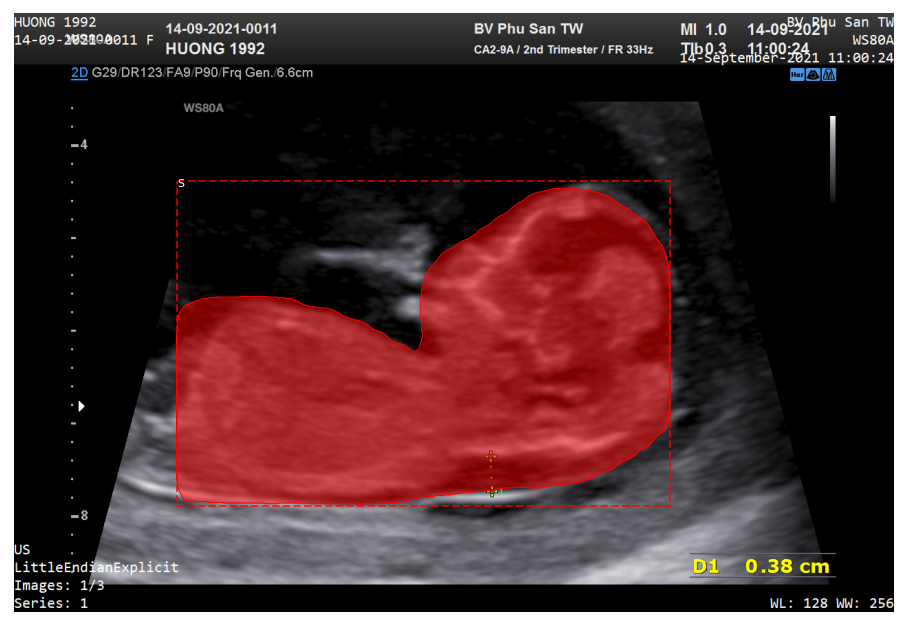

8e0ce245-MAY_2_0001_11.png


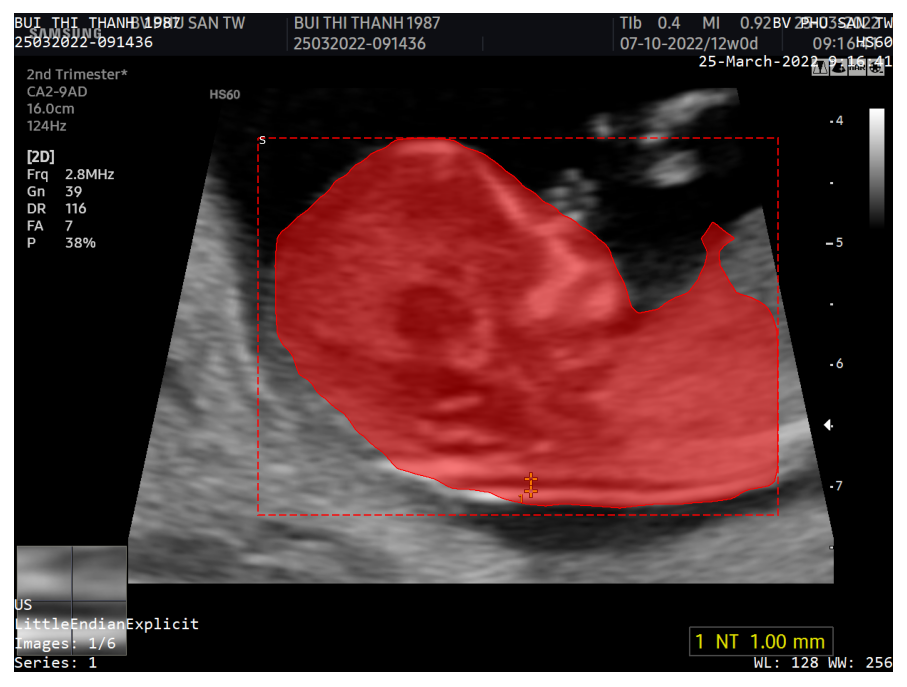

d677ec04-I0000003.png


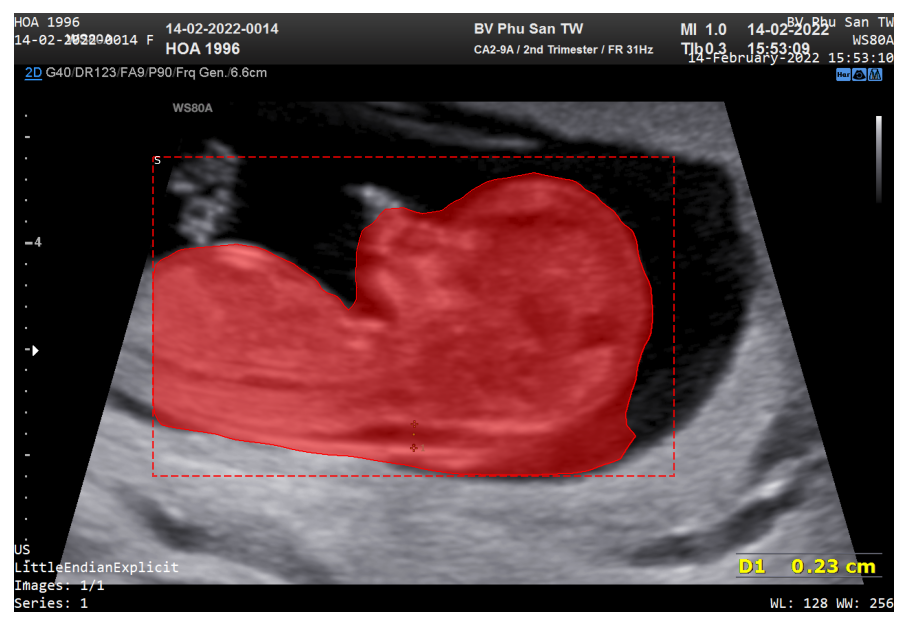

ab4459da-MAY_2_0001_7.png


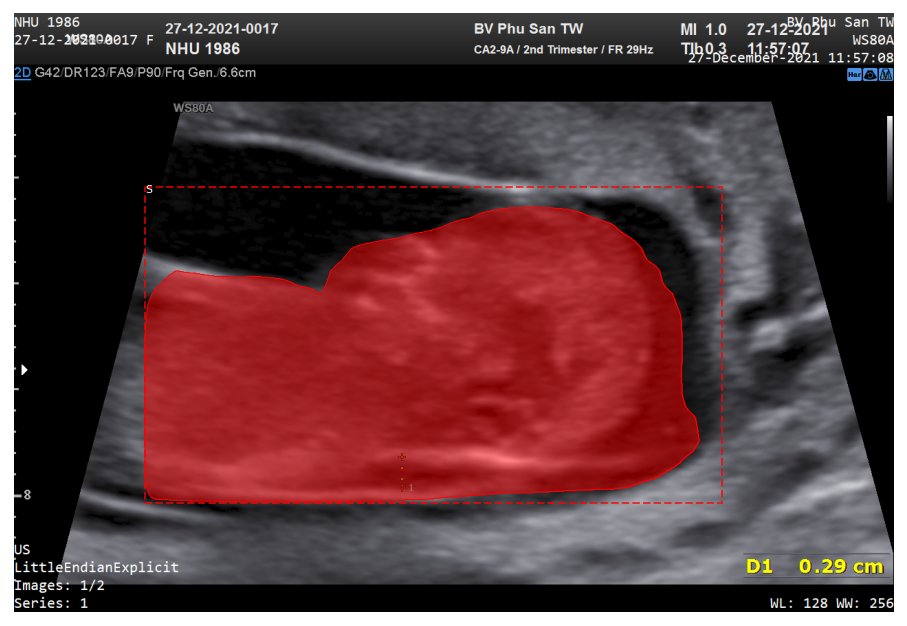

2df5fd51-MAY_2_0001_20.png


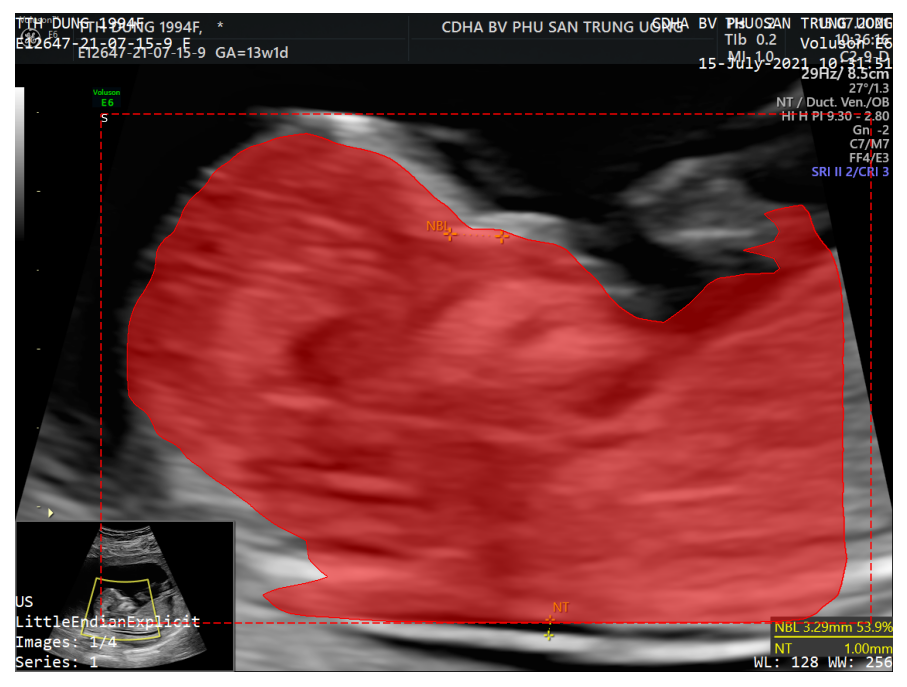

a659214d-I0000010_10.png


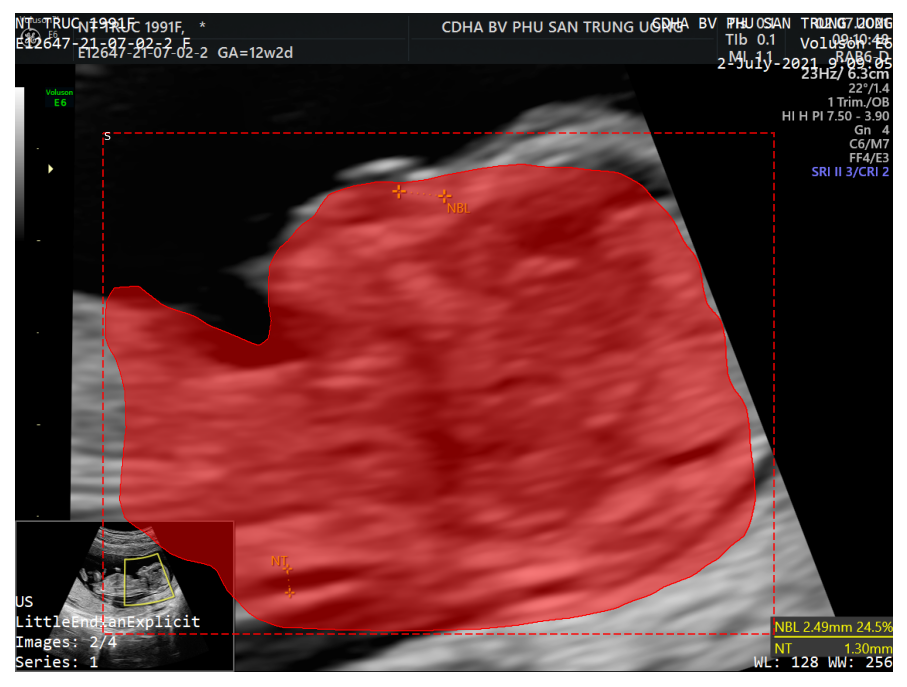

bdc3c607-I0000020_6.png


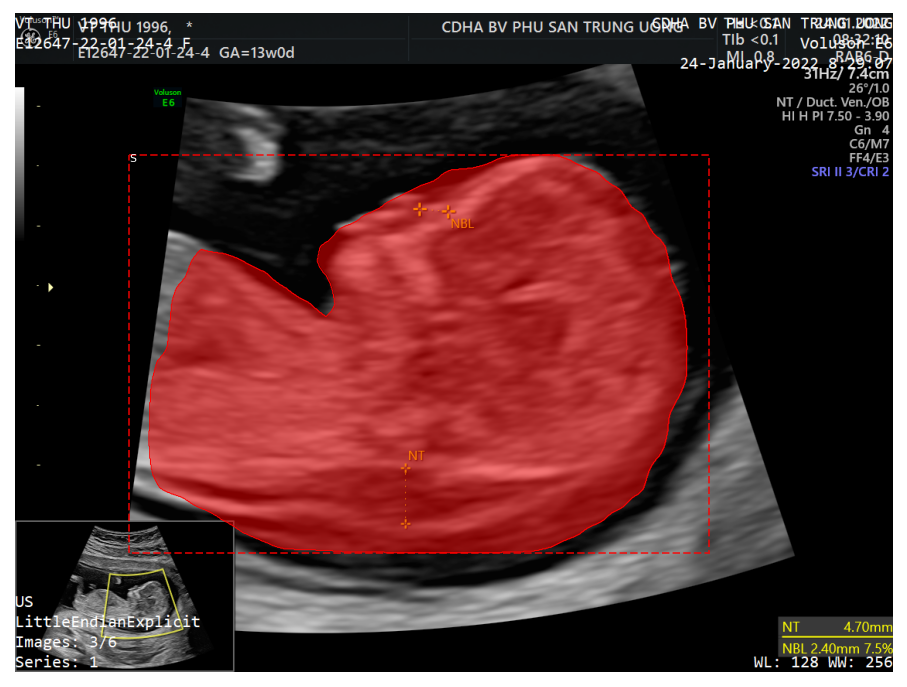

d7c7c4db-IMG_20220329_2_3.png


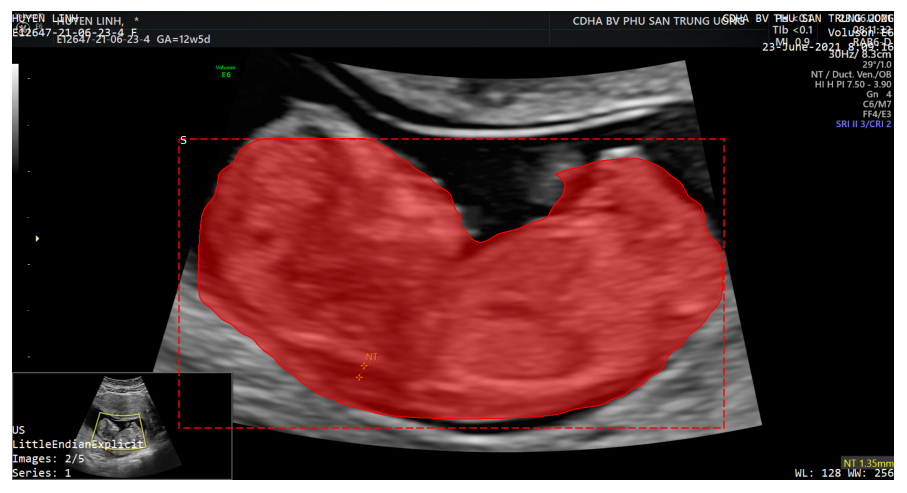

6eaf523b-I0000020_4.png


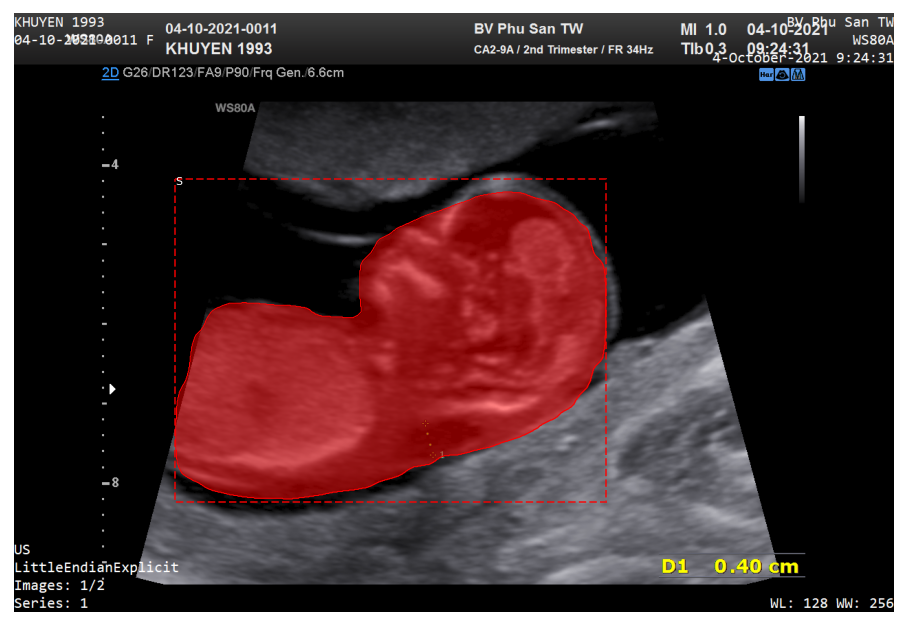

bb1a0293-MAY_2_0001_12.png


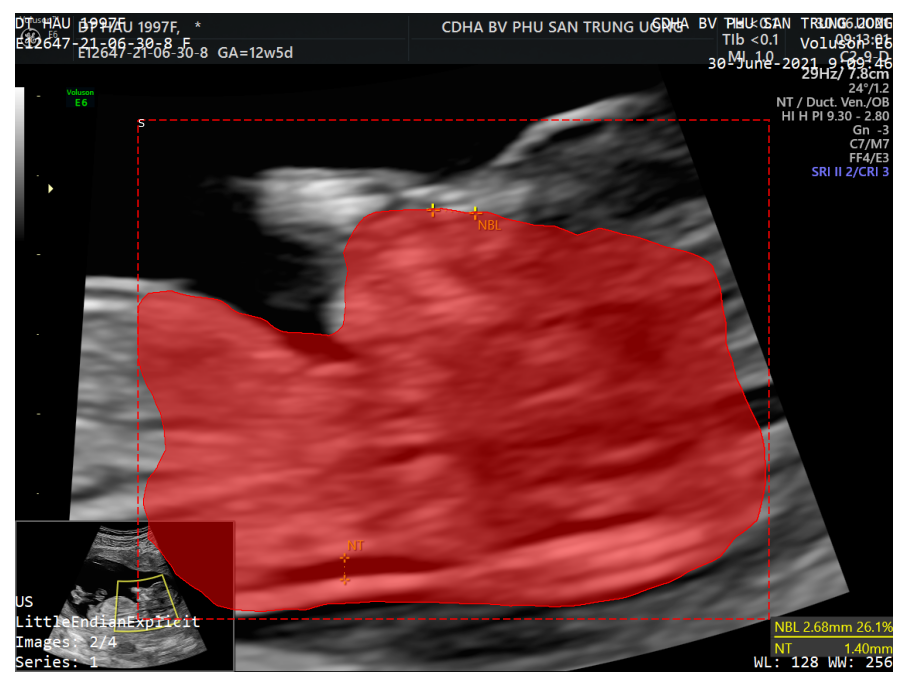

22cd9483-I0000020_1.png


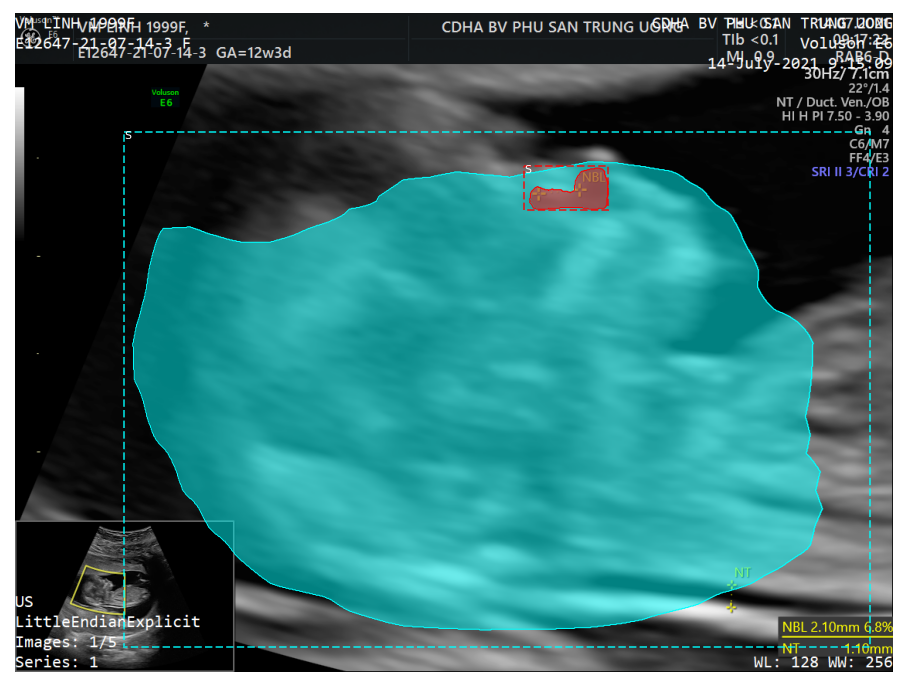

8053fd4b-I0000010_11.png


In [ ]:
import cv2
for path in list_path_file:
  image = cv2.imread(path)
  try:
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    r = model_final.detect([image])[0]
    img = display_instances_custom(image, r['rois'], r['masks'], r['class_ids'], class_names = 'SS')
    final_img = img.astype(np.float32)
    save_path = path.split('/')[-1]
    filename = '/content/drive/MyDrive/DATA/Result/save_path.png'
    cv2.imwrite(filename, final_img)
  except:
    print(path.split('/')[-1])


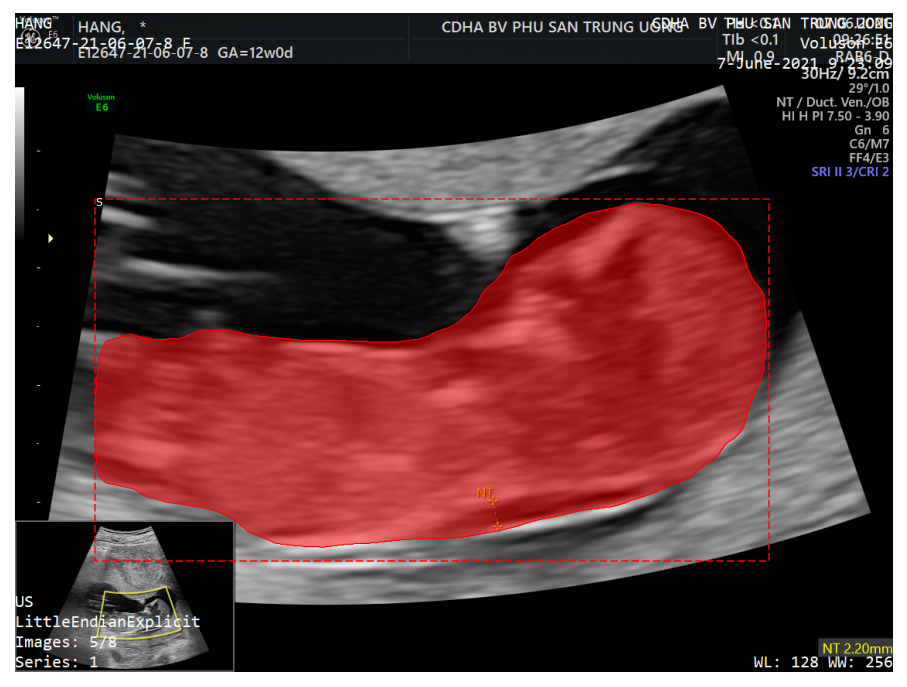

In [ ]:
path_test = "/content/drive/MyDrive/DATA/Datasets/images/cd1f903f-I0000050_1.png"
image = cv2.imread(path_test)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
r = model_final.detect([image])[0]
img_test = display_instances_custom(image, r['rois'], r['masks'], r['class_ids'], class_names = 'SS')

In [ ]:
print(img_test.dtype)

uint32


In [ ]:
resized_image = img_test.astype(np.float32)


In [ ]:
print(resized_image.dtype)

float32


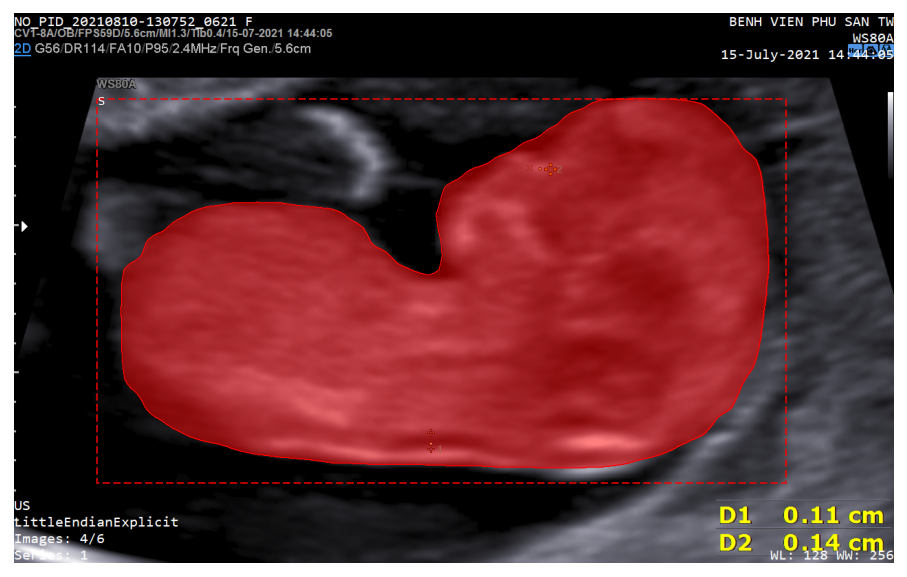

1592579f-P111_0004_8.png


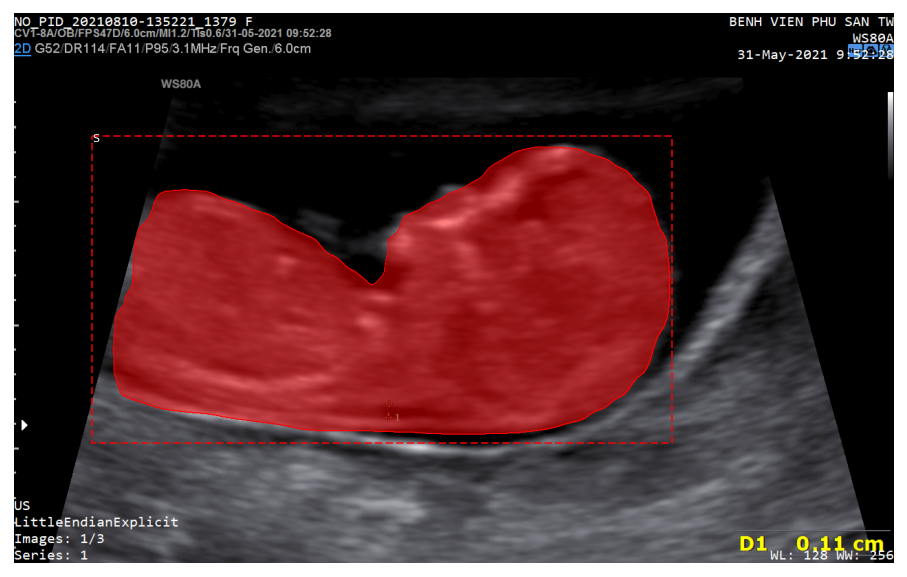

84ed3b7d-P111_0001_36.png


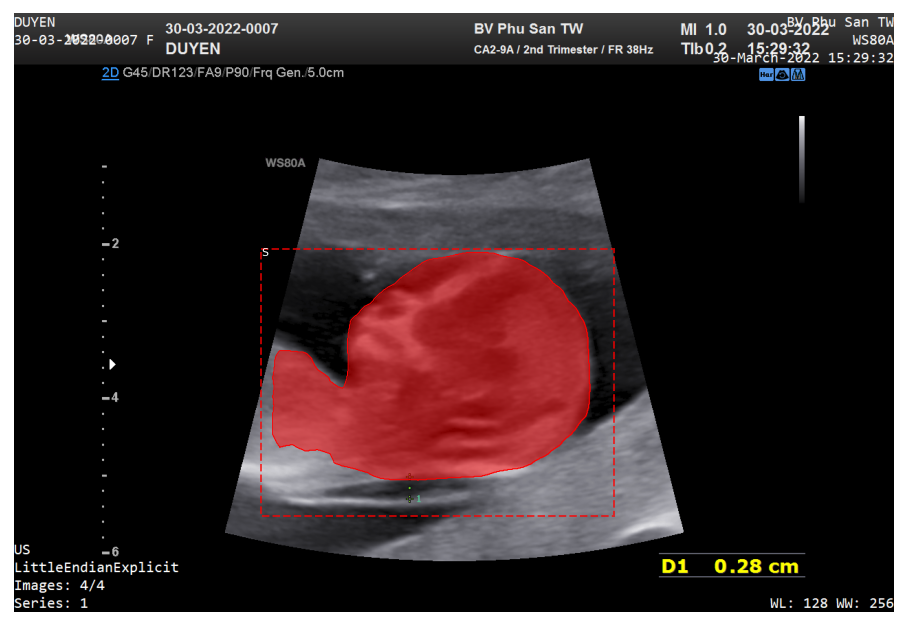

9870dfdc-MAY2_0004.png


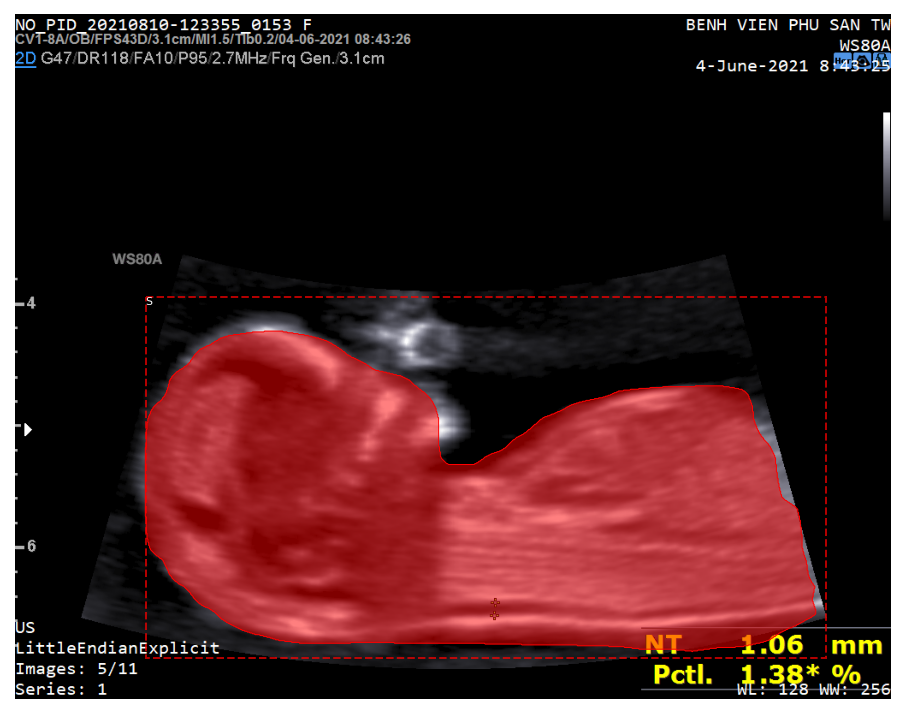

54c04308-P111_0005_1.png


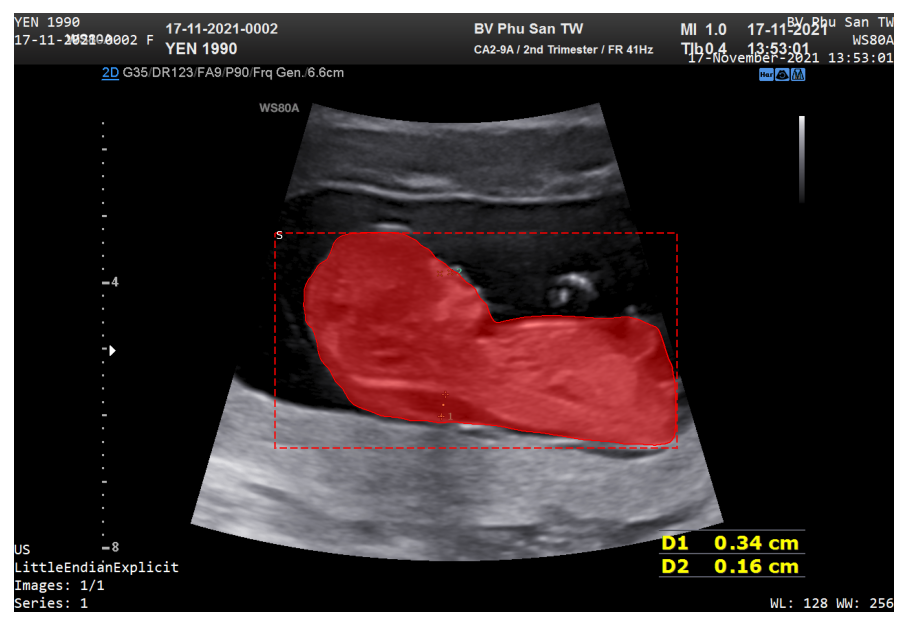

0395c4a3-MAY_2_0001_26.png


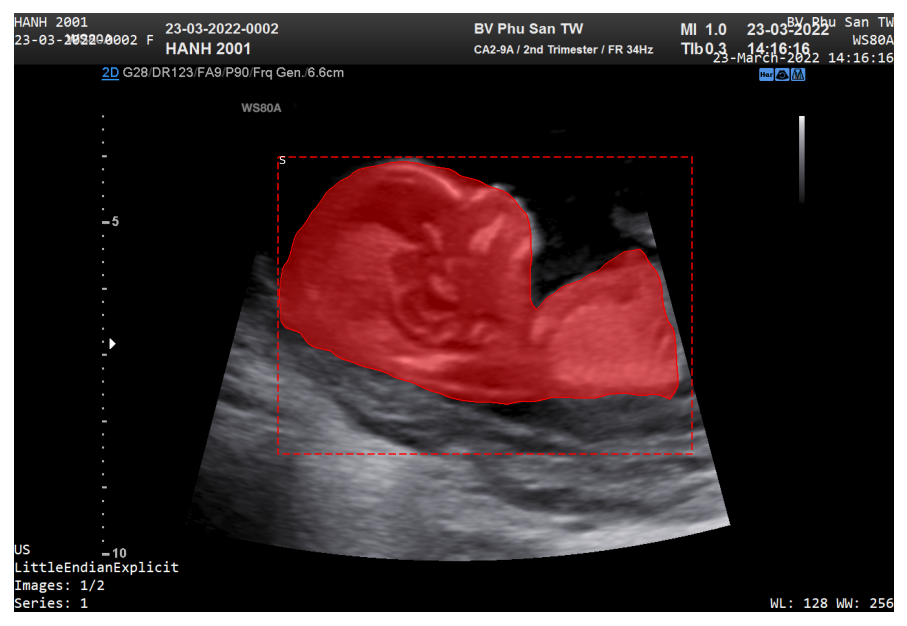

efb61049-MAY2_0001_16.png


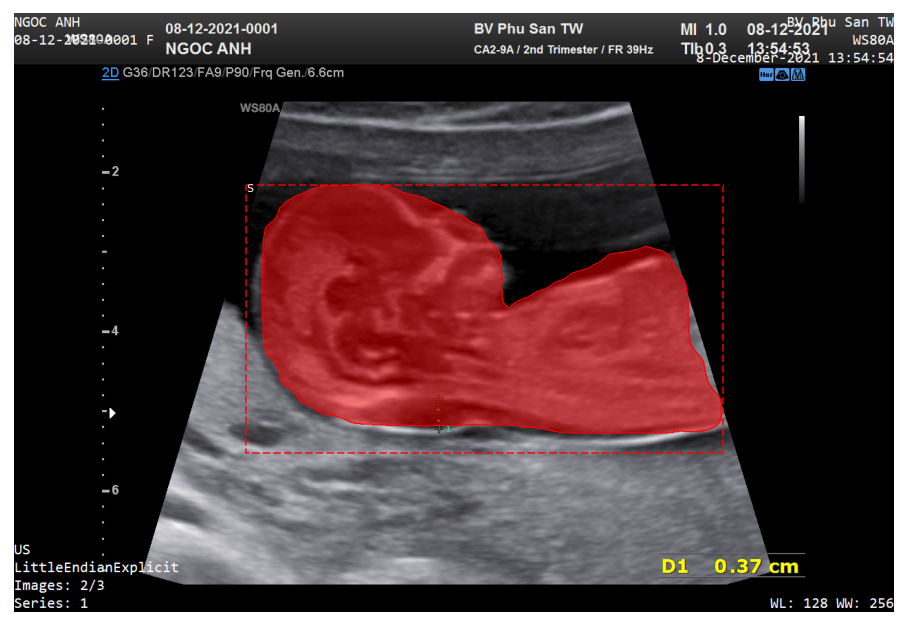

95f0992c-MAY_2_0002_14.png


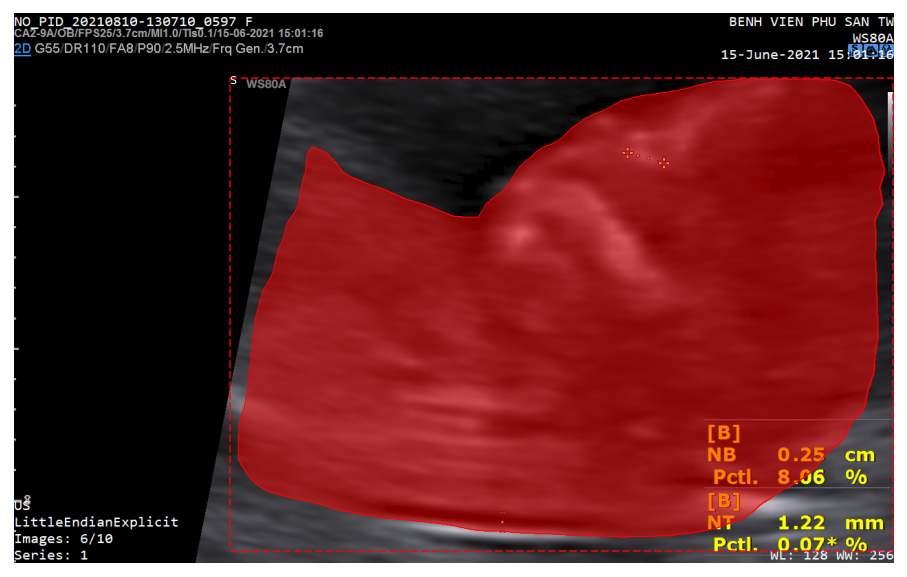

beb221c2-P111_0006_6.png


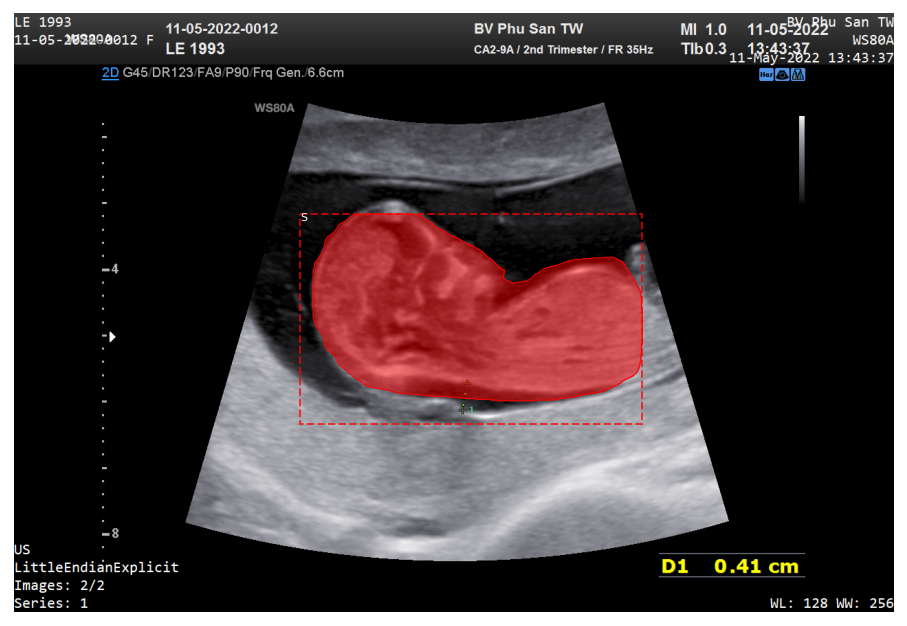

5956b5ad-MAY2_0002_23.png


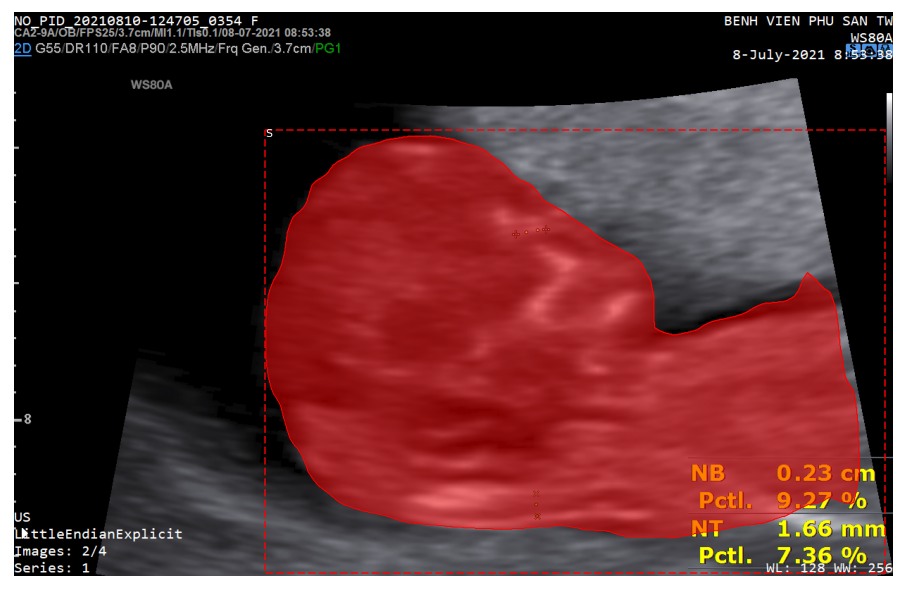

b21de7d8-P111_0002_10.png


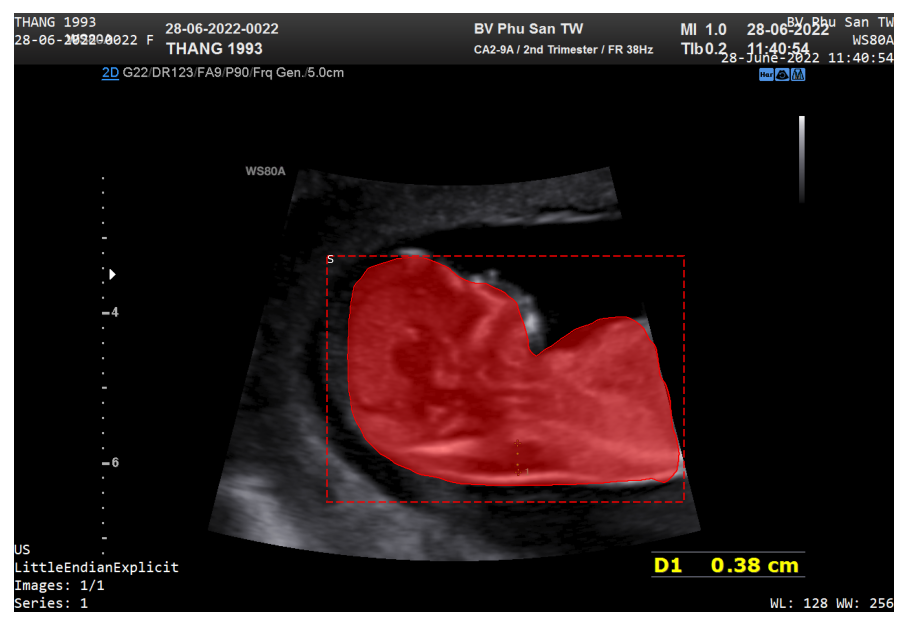

2d0ff7e4-MAY2_0001_58.png


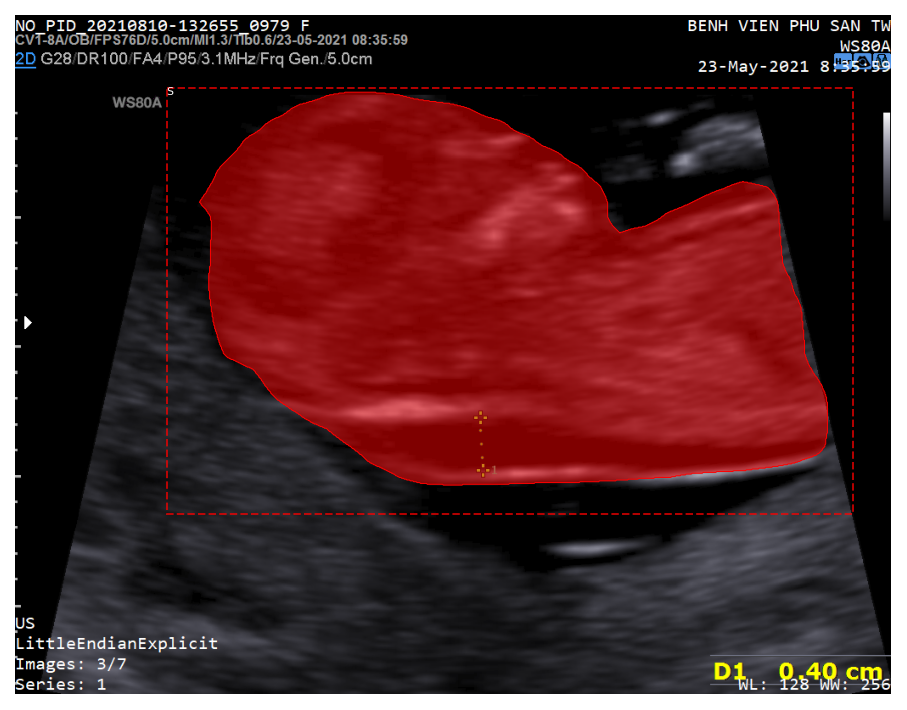

1cd5d3f2-P111_0003_26.png


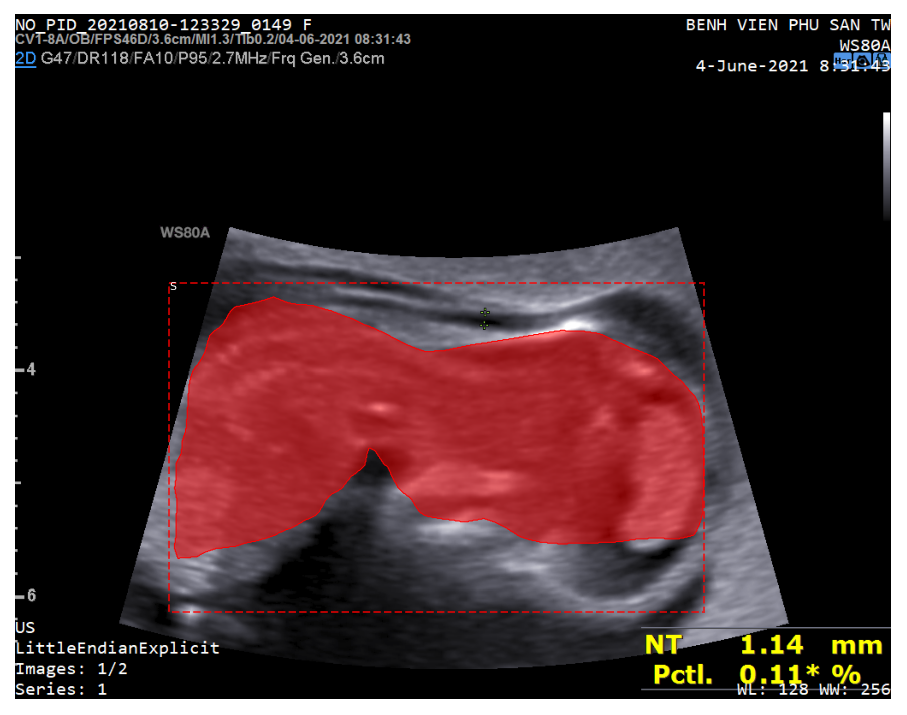

b10436ad-P111_0004_1.png


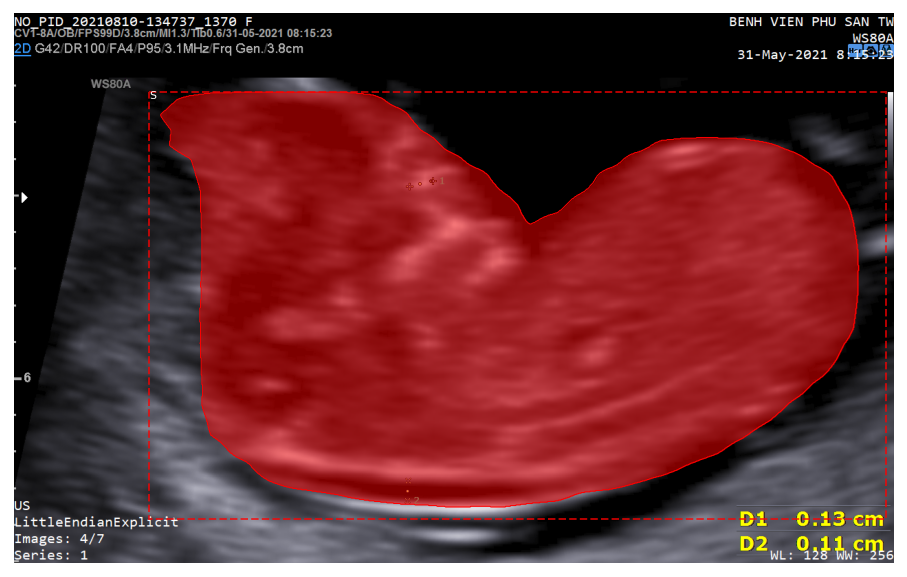

722945f0-P111_0004_24.png


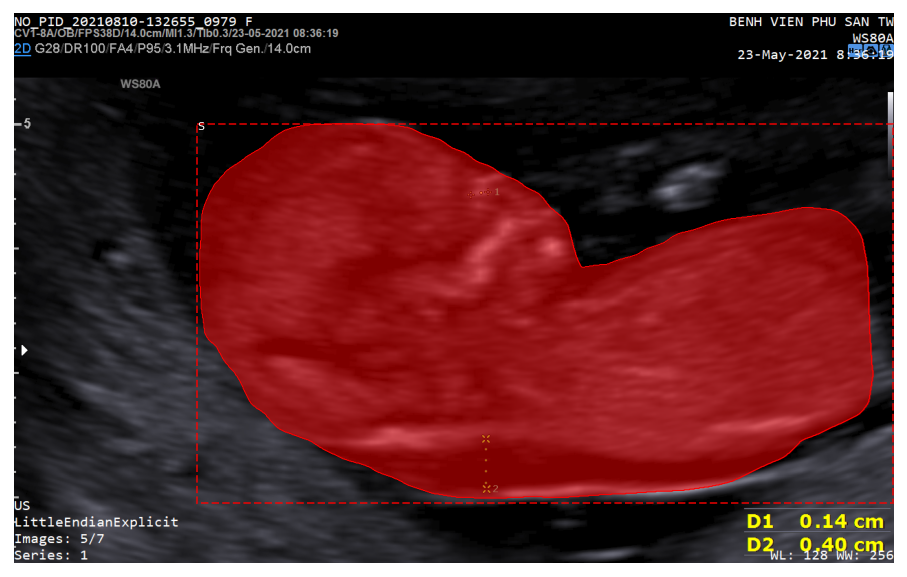

741c2001-P111_0005_9.png


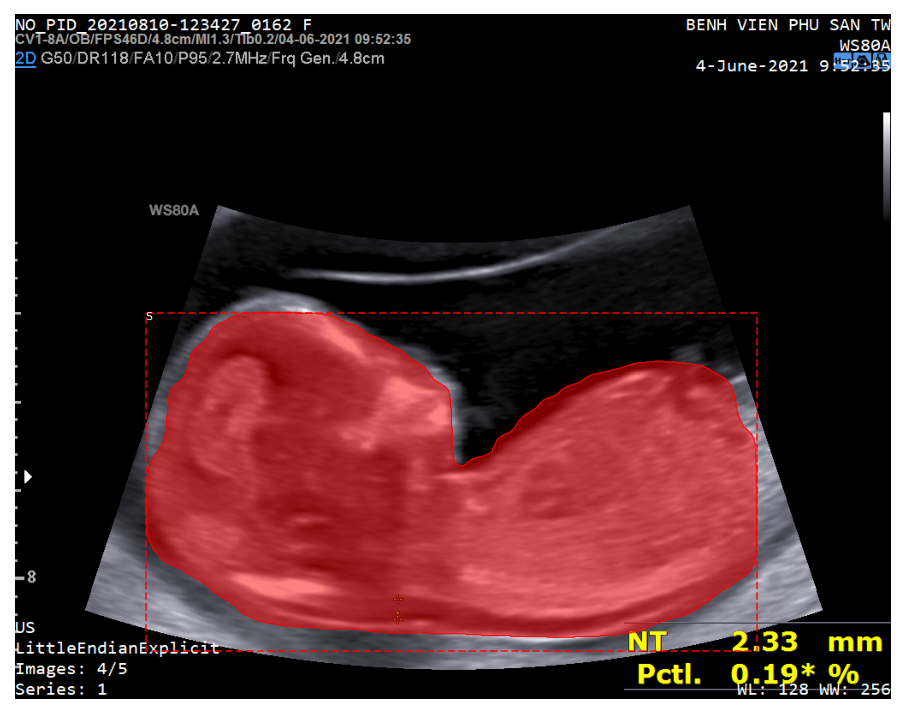

efdced2b-P111_0004_3.png


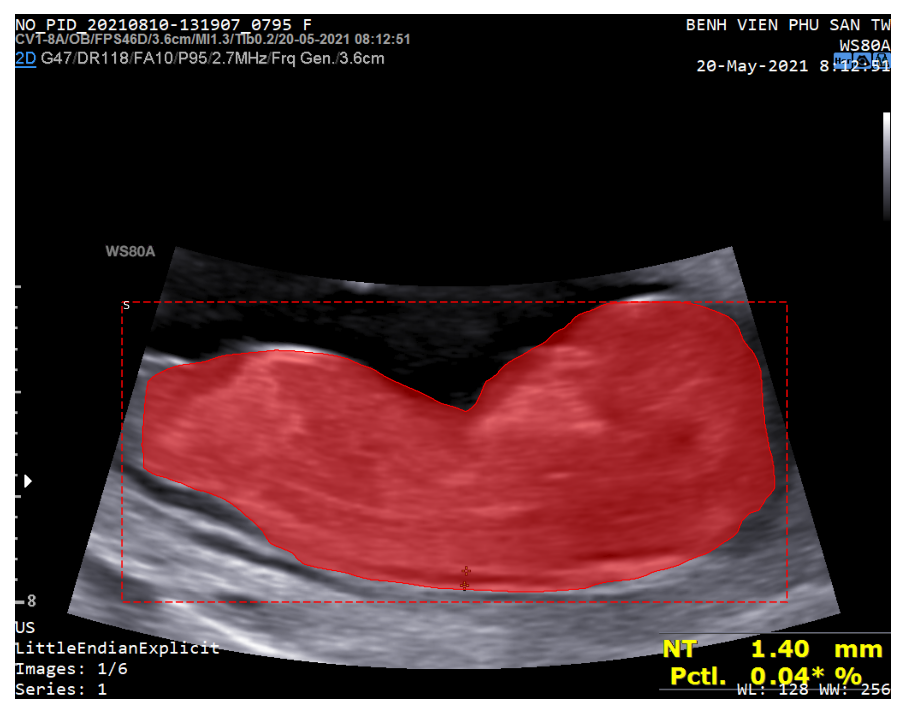

268d00c3-P111_0001_19.png


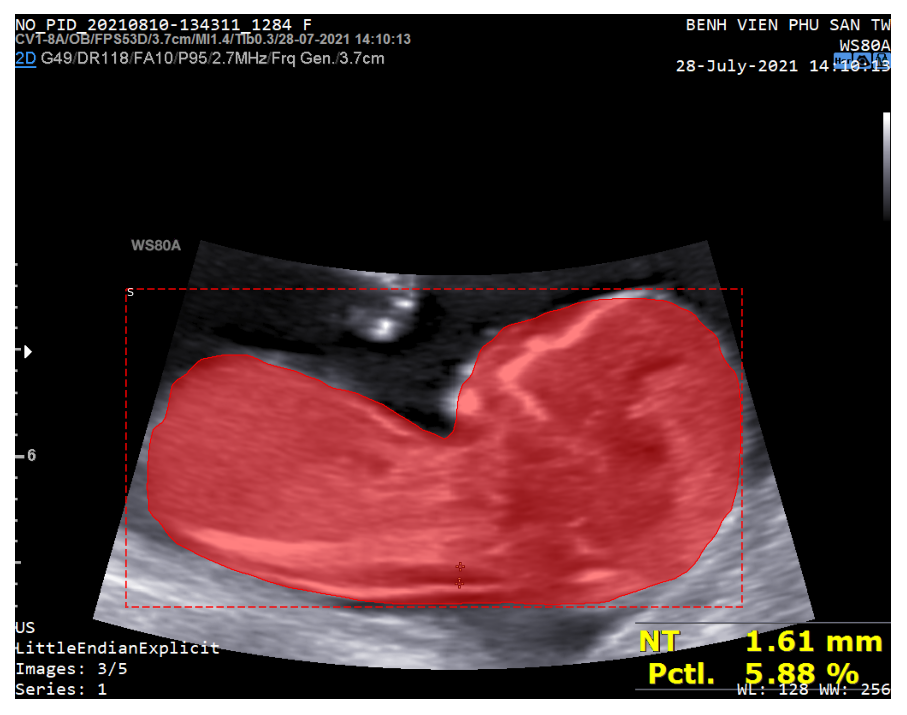

93bb6c9c-P111_0003_41.png


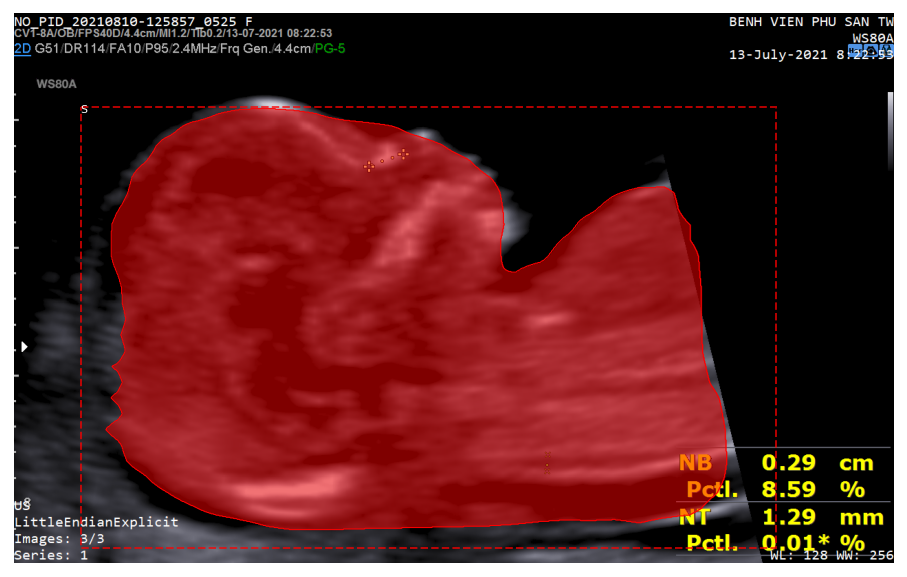

d246d569-P111_0003_14.png


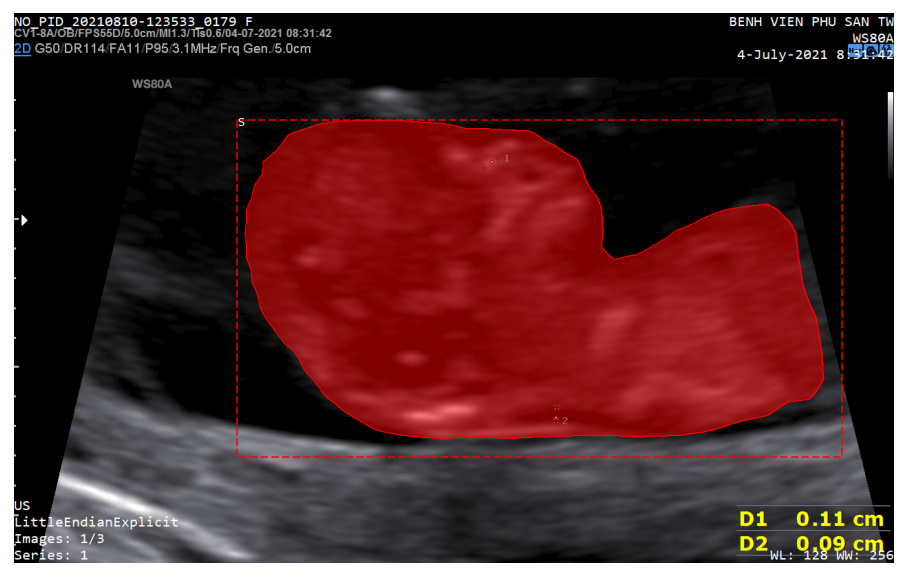

eb886227-P111_0001_7.png


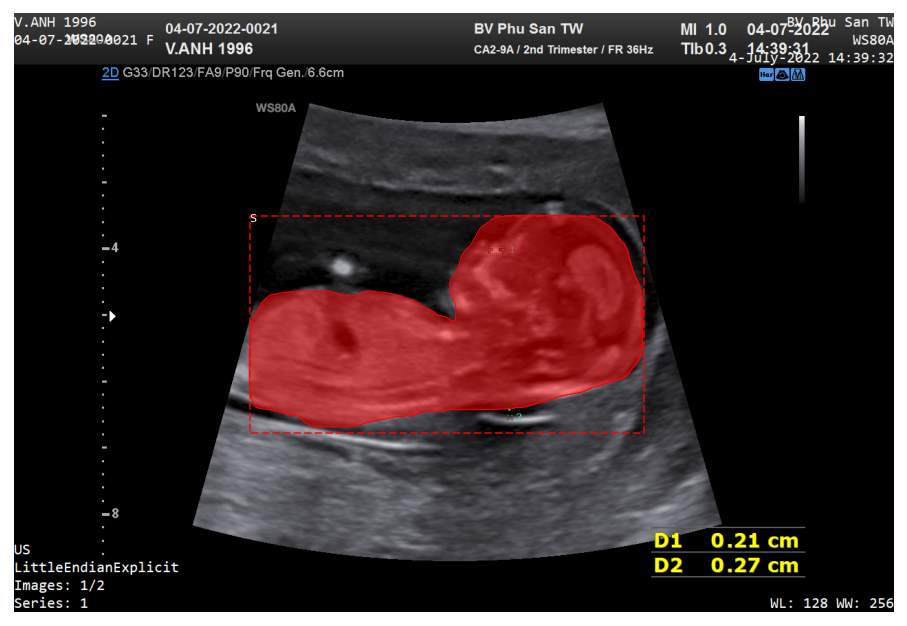

c80f3fab-MAY2_0001_73.png


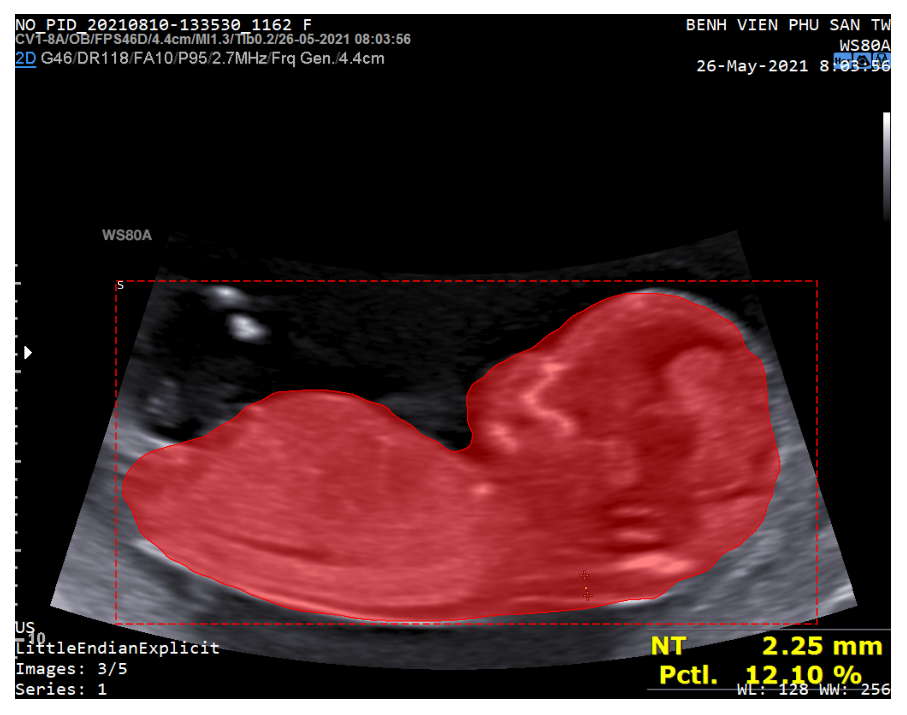

00a115ac-P111_0003_35.png


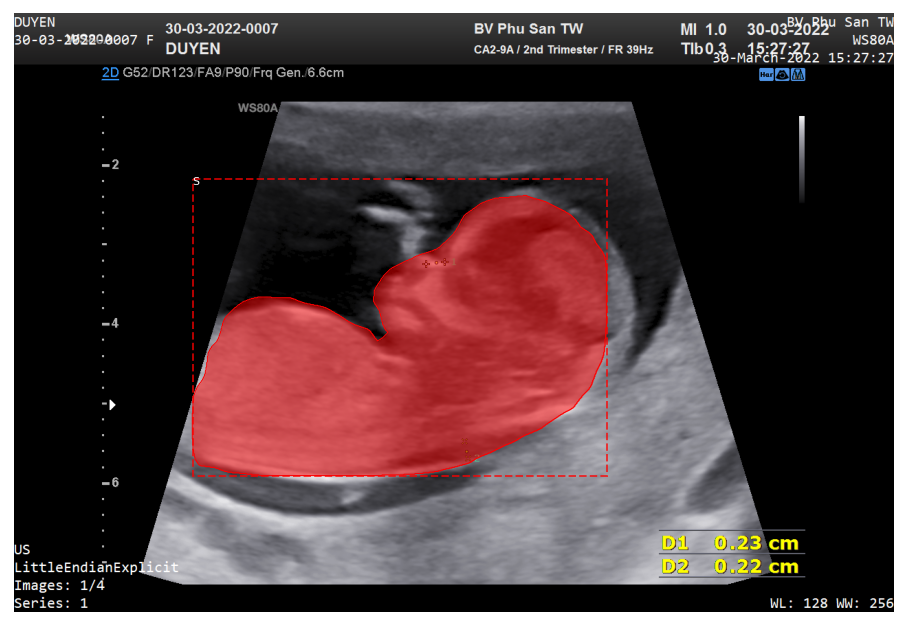

f08a23cc-MAY2_0001_9.png


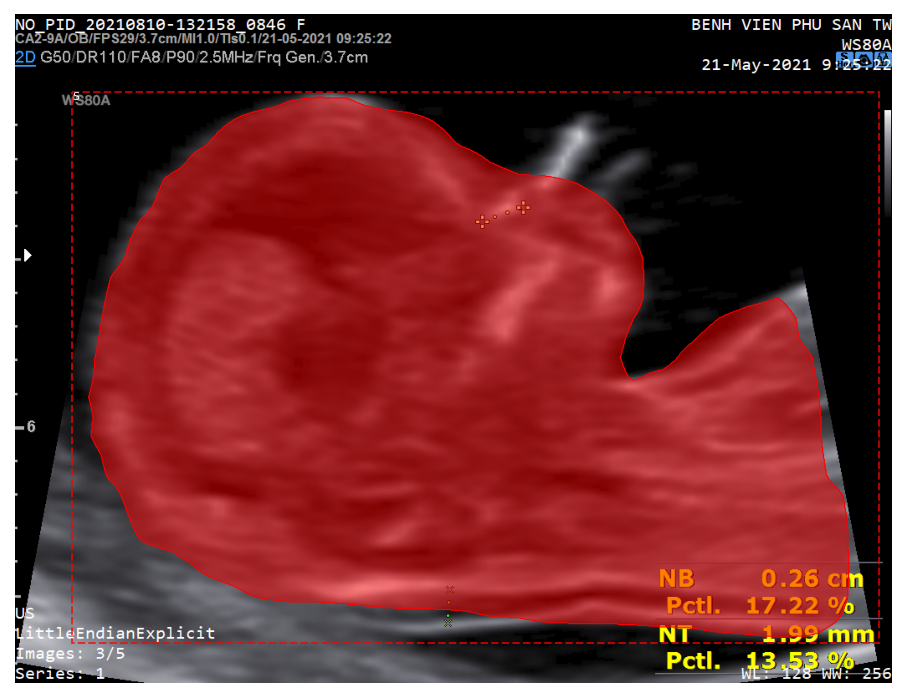

c837798a-P111_0003_20.png


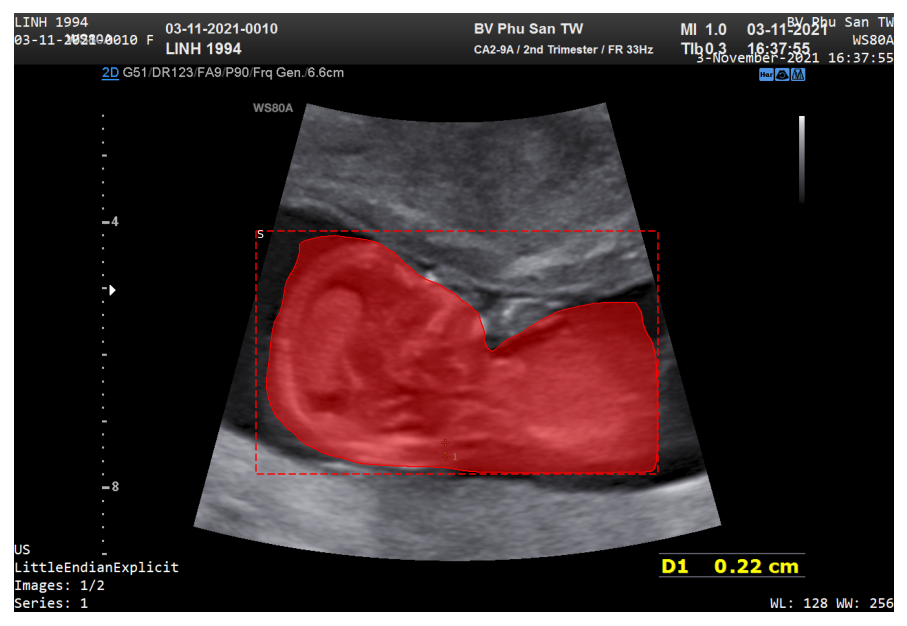

f3ccad84-MAY2_0001_45.png


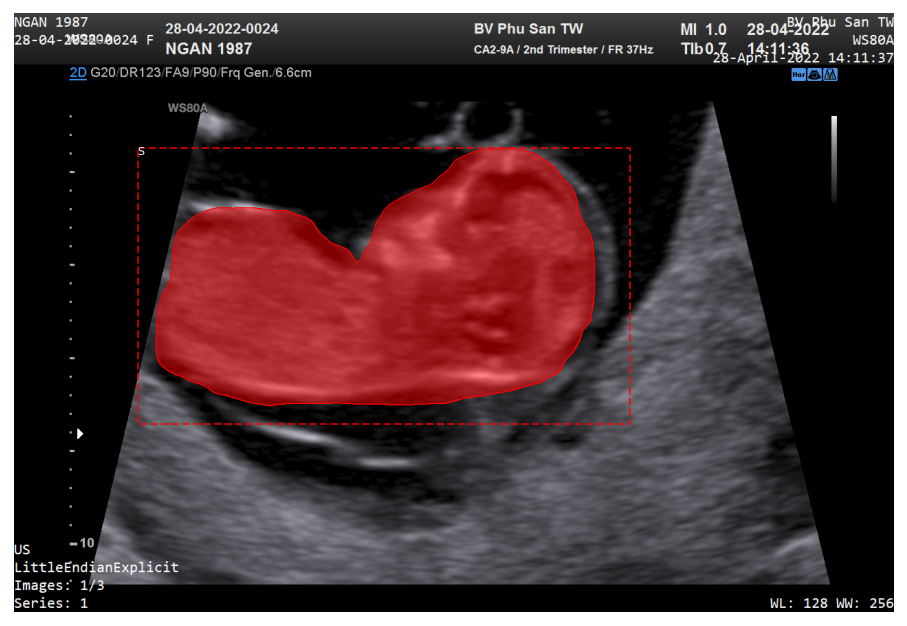

446200d6-MAY2_0001_50.png


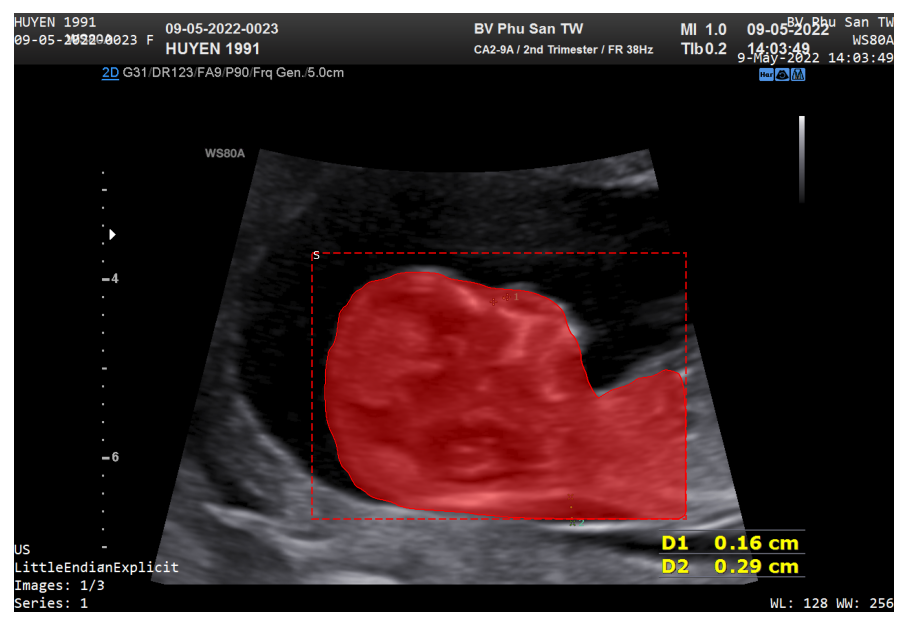

13386bbd-MAY2_0001_31.png


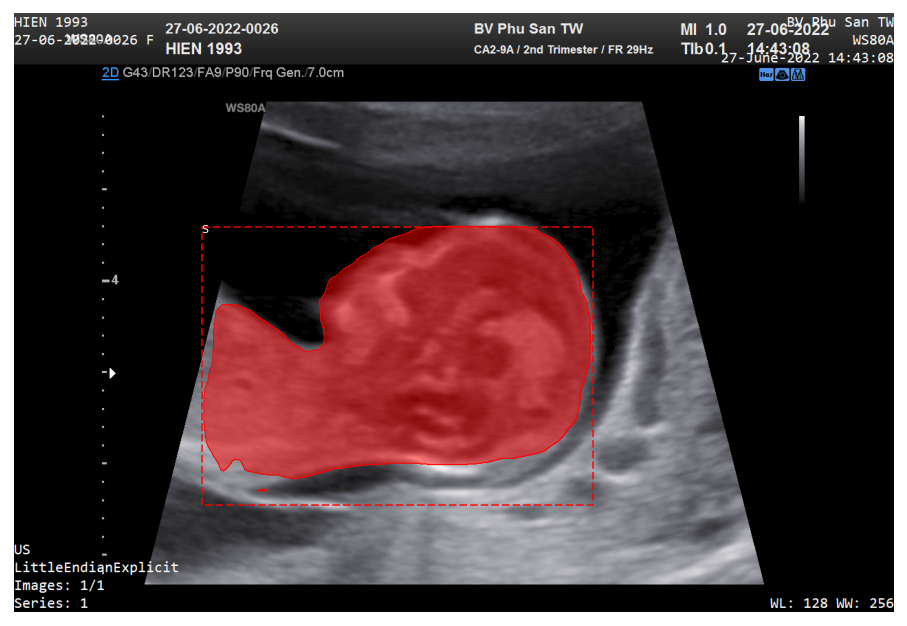

fe5cae8a-MAY2_0001_18.png


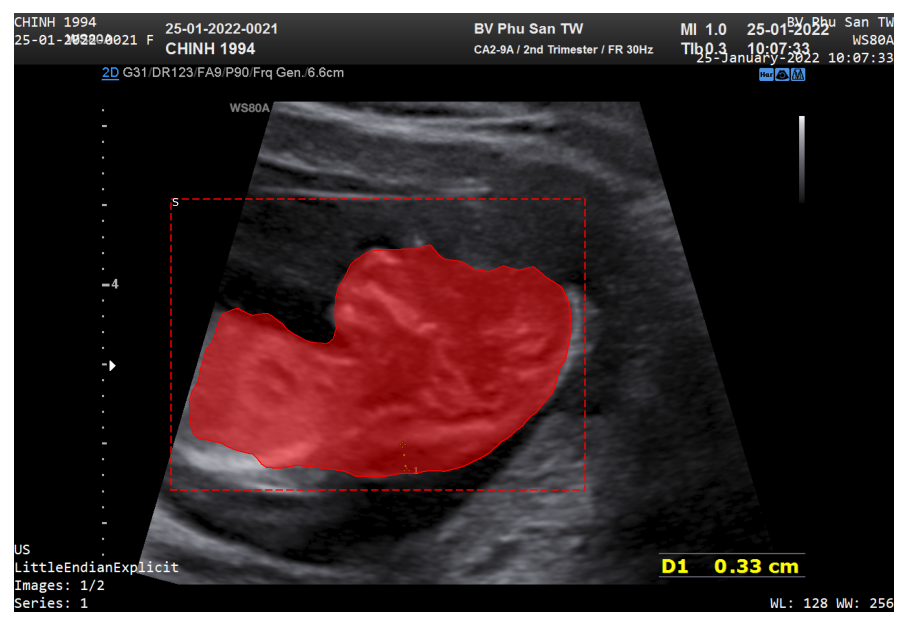

e91933d6-MAY2_0001_6.png

*** No instances to display * 

8450287c-MAY2_0001_70.png


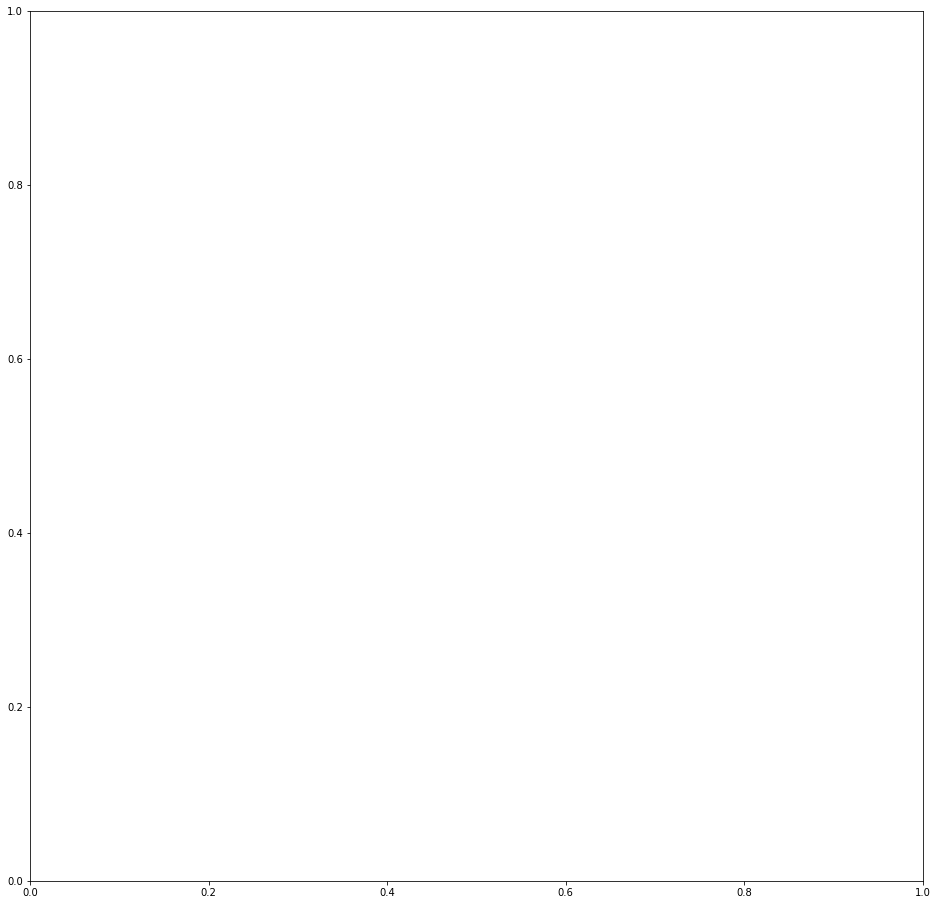

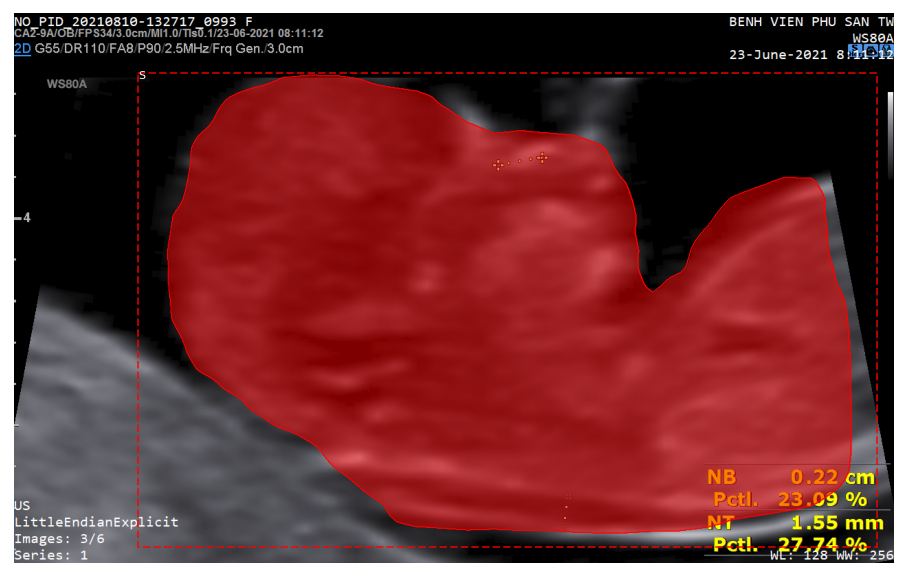

8b8e5e0f-P111_0003_27.png


In [ ]:
import cv2
for path in list_path_file:
  image = cv2.imread(path)
  try:
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    r = model_final.detect([image])[0]
    img = display_instances_custom(image, r['rois'], r['masks'], r['class_ids'], class_names = 'SS')
    mask = r['masks']
    mask = mask.astype(int)
    mask.shape
    for i in range(mask.shape[2]):
        temp = cv2.imread(path_test)
        for j in range(temp.shape[2]):
            temp[:,:,j] = temp[:,:,j] * mask[:,:,i]
        plt.figure(figsize=(8,8))
        plt.imshow(temp)
  except:
    print(path.split('/')[-1])

In [ ]:
mask = r['masks']
mask = mask.astype(int)
mask.shape

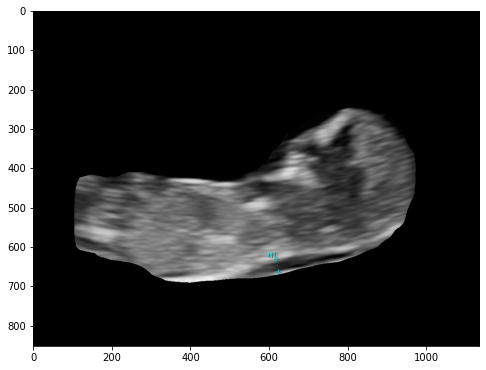

In [ ]:
for i in range(mask.shape[2]):
    temp = cv2.imread(path_test)
    for j in range(temp.shape[2]):
        temp[:,:,j] = temp[:,:,j] * mask[:,:,i]
    plt.figure(figsize=(8,8))
    plt.imshow(temp)

In [ ]:
print(temp.dtype)

uint8


In [ ]:
cv2.imwrite('/content/drive/MyDrive/computer vision/result.png', temp)

True